In [1]:
# import library

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import datasets, transforms, models
import numpy as np
import matplotlib.pyplot as plt
import os
import shutil
from PIL import Image
from pathlib import Path
from typing import Dict, List

In [2]:
# Truy cap den duong dan thu muc anh
root_dir = r'D:\DoAnChuyenNganh_TTNT\datasets'

labels = os.listdir(root_dir)
print(labels)
print(len(labels))

['Akshay Kumar', 'Alexandra Daddario', 'Alia Bhatt', 'Amitabh Bachchan', 'Andy Samberg', 'Anushka Sharma', 'Billie Eilish', 'Brad Pitt', 'Camila Cabello', 'Charlize Theron', 'Claire Holt', 'Courtney Cox', 'Dwayne Johnson', 'Elizabeth Olsen', 'Ellen Degeneres', 'Henry Cavill', 'Hrithik Roshan', 'Hugh Jackman', 'Jessica Alba', 'Kashyap', 'Lisa Kudrow', 'Margot Robbie', 'Marmik', 'Natalie Portman', 'Priyanka Chopra', 'Robert Downey Jr', 'Roger Federer', 'Tom Cruise', 'Vijay Deverakonda', 'Virat Kohli', 'Zac Efron']
31


Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Akshay Kumar\Akshay Kumar_44.jpg
Image class: Akshay Kumar
Image height: 100
Image width: 100


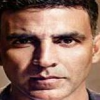

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Alexandra Daddario\Alexandra Daddario_2.jpg
Image class: Alexandra Daddario
Image height: 100
Image width: 100


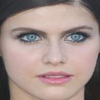

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Alia Bhatt\Alia Bhatt_24.jpg
Image class: Alia Bhatt
Image height: 100
Image width: 100


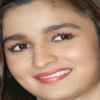

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Amitabh Bachchan\Amitabh Bachchan_25.jpg
Image class: Amitabh Bachchan
Image height: 100
Image width: 100


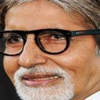

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Andy Samberg\Andy Samberg_34.jpg
Image class: Andy Samberg
Image height: 100
Image width: 100


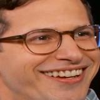

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Anushka Sharma\Anushka Sharma_10.jpg
Image class: Anushka Sharma
Image height: 100
Image width: 100


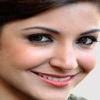

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Billie Eilish\Billie Eilish_22.jpg
Image class: Billie Eilish
Image height: 100
Image width: 100


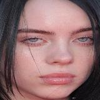

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Brad Pitt\Brad Pitt_117.jpg
Image class: Brad Pitt
Image height: 100
Image width: 100


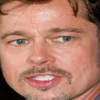

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Camila Cabello\Camila Cabello_2.jpg
Image class: Camila Cabello
Image height: 100
Image width: 100


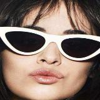

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Charlize Theron\Charlize Theron_24.jpg
Image class: Charlize Theron
Image height: 100
Image width: 100


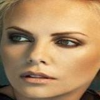

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Claire Holt\Claire Holt_19.jpg
Image class: Claire Holt
Image height: 100
Image width: 100


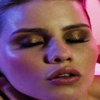

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Courtney Cox\Courtney Cox_29.jpg
Image class: Courtney Cox
Image height: 100
Image width: 100


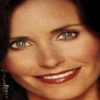

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Dwayne Johnson\Dwayne Johnson_30.jpg
Image class: Dwayne Johnson
Image height: 100
Image width: 100


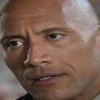

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Elizabeth Olsen\Elizabeth Olsen_15.jpg
Image class: Elizabeth Olsen
Image height: 100
Image width: 100


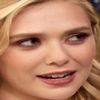

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Ellen Degeneres\Ellen Degeneres_28.jpg
Image class: Ellen Degeneres
Image height: 100
Image width: 100


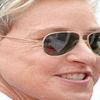

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Henry Cavill\Henry Cavill_13.jpg
Image class: Henry Cavill
Image height: 100
Image width: 100


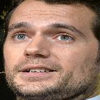

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Hrithik Roshan\Hrithik Roshan_27.jpg
Image class: Hrithik Roshan
Image height: 100
Image width: 100


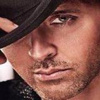

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Hugh Jackman\Hugh Jackman_104.jpg
Image class: Hugh Jackman
Image height: 100
Image width: 100


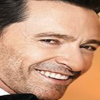

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Jessica Alba\Jessica Alba_104 (1).jpg
Image class: Jessica Alba
Image height: 100
Image width: 100


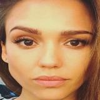

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Kashyap\Kashyap_23.jpg
Image class: Kashyap
Image height: 100
Image width: 100


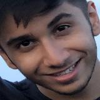

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Lisa Kudrow\Lisa Kudrow_20.jpg
Image class: Lisa Kudrow
Image height: 100
Image width: 100


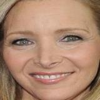

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Margot Robbie\Margot Robbie_28.jpg
Image class: Margot Robbie
Image height: 100
Image width: 100


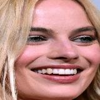

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Marmik\Marmik_24.jpg
Image class: Marmik
Image height: 100
Image width: 100


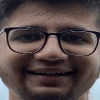

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Natalie Portman\Natalie Portman_22.jpg
Image class: Natalie Portman
Image height: 100
Image width: 100


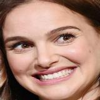

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Priyanka Chopra\Priyanka Chopra_28.jpg
Image class: Priyanka Chopra
Image height: 100
Image width: 100


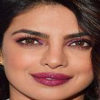

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Robert Downey Jr\Robert Downey Jr_11.jpg
Image class: Robert Downey Jr
Image height: 100
Image width: 100


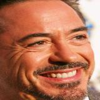

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Roger Federer\Roger Federer_22.jpg
Image class: Roger Federer
Image height: 100
Image width: 100


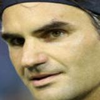

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Tom Cruise\Tom Cruise_27.jpg
Image class: Tom Cruise
Image height: 100
Image width: 100


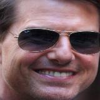

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Vijay Deverakonda\Vijay Deverakonda_13.jpg
Image class: Vijay Deverakonda
Image height: 100
Image width: 100


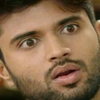

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Virat Kohli\Virat Kohli_15.jpg
Image class: Virat Kohli
Image height: 100
Image width: 100


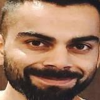

Random image path: D:\DoAnChuyenNganh_TTNT\datasets\Zac Efron\Zac Efron_18.jpg
Image class: Zac Efron
Image height: 100
Image width: 100


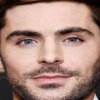

In [3]:
import random

(height, width) = (100, 100)

for label in labels:
    label_path = os.path.join(root_dir, label)
    if os.path.isdir(label_path): # Check if it's a directory
        # Filter for image files (e.g., .jpg, .png, .jpeg)
        files = [f for f in os.listdir(label_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        if files:  # Check if the directory is not empty
            random_image_file = random.choice(files)  # Select a random image file
            random_image_path = os.path.join(label_path, random_image_file)  # Form the full path of the random image
            try:
                image = Image.open(random_image_path)
                image = image.resize((height, width))
                category = label  # The category is the label

                print(f"Random image path: {random_image_path}")
                print(f"Image class: {category}")
                print(f"Image height: {image.height}") 
                print(f"Image width: {image.width}")

                display(image)
            except IOError:
                print(f"Cannot open image: {random_image_path}")


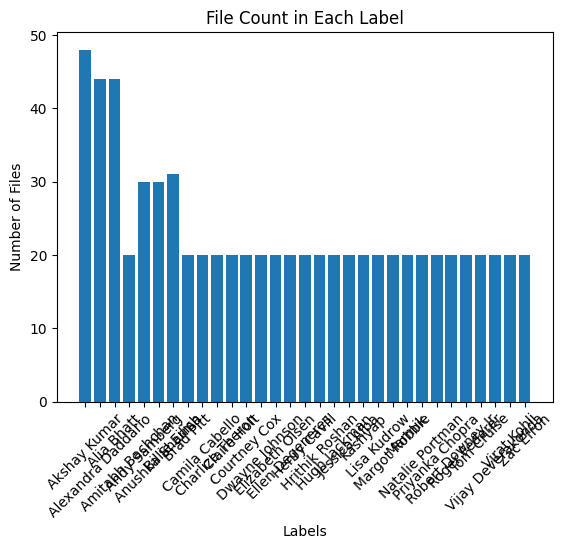

In [4]:
# visualize number of files in each category
file_counts = [len(os.listdir(os.path.join(root_dir, label))) for label in labels]
# print(file_counts)

# Create a dictionary to map labels to file counts
label_file_count = dict(zip(labels, file_counts))
# print(label_file_count)

# Create a histogram
plt.bar(label_file_count.keys(), label_file_count.values())
plt.xlabel('Labels')
plt.ylabel('Number of Files')
plt.title('File Count in Each Label')
plt.xticks(rotation=45)
plt.show()

In [5]:
label_file_count

{'Akshay Kumar': 48,
 'Alexandra Daddario': 44,
 'Alia Bhatt': 44,
 'Amitabh Bachchan': 20,
 'Andy Samberg': 30,
 'Anushka Sharma': 30,
 'Billie Eilish': 31,
 'Brad Pitt': 20,
 'Camila Cabello': 20,
 'Charlize Theron': 20,
 'Claire Holt': 20,
 'Courtney Cox': 20,
 'Dwayne Johnson': 20,
 'Elizabeth Olsen': 20,
 'Ellen Degeneres': 20,
 'Henry Cavill': 20,
 'Hrithik Roshan': 20,
 'Hugh Jackman': 20,
 'Jessica Alba': 20,
 'Kashyap': 20,
 'Lisa Kudrow': 20,
 'Margot Robbie': 20,
 'Marmik': 20,
 'Natalie Portman': 20,
 'Priyanka Chopra': 20,
 'Robert Downey Jr': 20,
 'Roger Federer': 20,
 'Tom Cruise': 20,
 'Vijay Deverakonda': 20,
 'Virat Kohli': 20,
 'Zac Efron': 20}

In [6]:
data_transform = transforms.Compose([
    transforms.Resize((120, 120)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [7]:
def plot_transformed_images(root_dir, transform, n=1, seed=42):
    random.seed(seed)

    for label in labels:
        label_path = os.path.join(root_dir, label)
        if os.path.isdir(label_path):  # Check if it's a directory
            # Get all image file paths
            image_paths = [os.path.join(label_path, f) for f in os.listdir(label_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

            if not image_paths:
                print(f"No images found in {label_path}")
                continue

            # Randomly select 'n' images or take all if there are fewer than 'n'
            random_image_paths = random.sample(image_paths, min(n, len(image_paths)))

            for image_path in random_image_paths:
                with Image.open(image_path) as img:
                    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
                    ax[0].imshow(img) 
                    ax[0].set_title(f"Original\nSize: {img.size}")
                    ax[0].axis("off")

                    # Apply transformation and permute tensor for display
                    transformed_image = transform(img).permute(1, 2, 0).numpy()
                    ax[1].imshow(transformed_image) 
                    ax[1].set_title(f"Transformed\nSize: {transformed_image.shape}")
                    ax[1].axis("off")

                    image_path = Path(image_path)
                    fig.suptitle(f"Class: {image_path.parent.stem}", fontsize=16)
                    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.6051416].


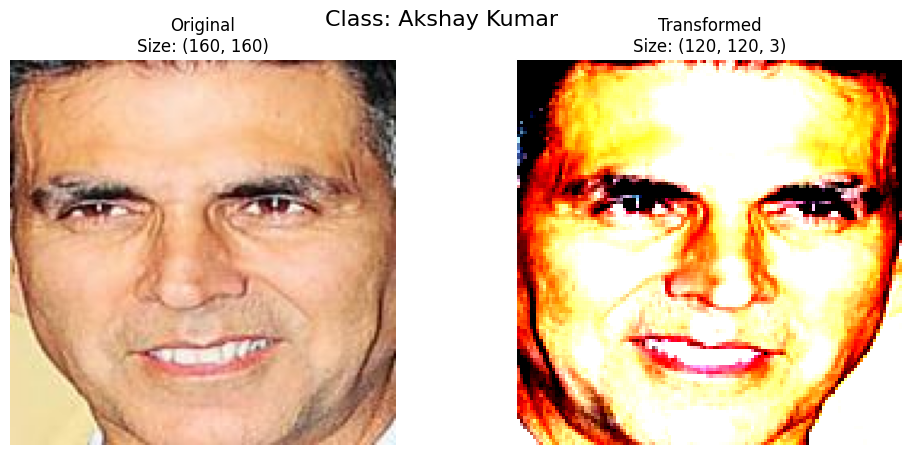

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.5877128].


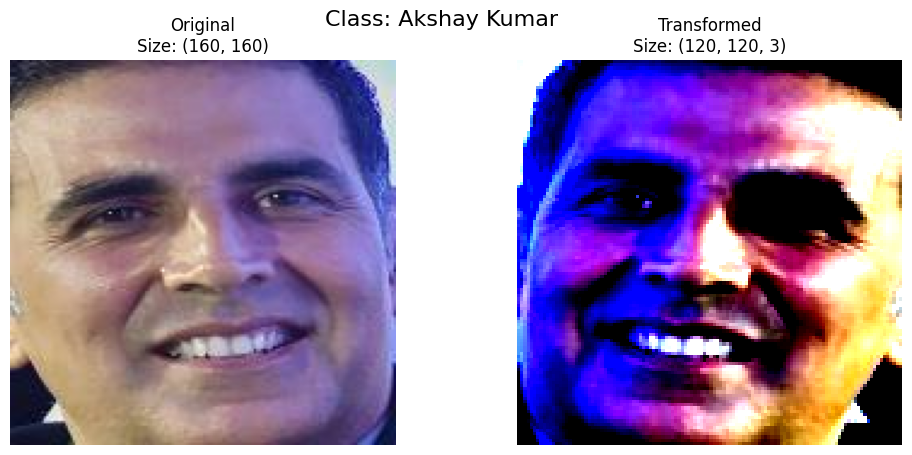

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8606442..2.2489083].


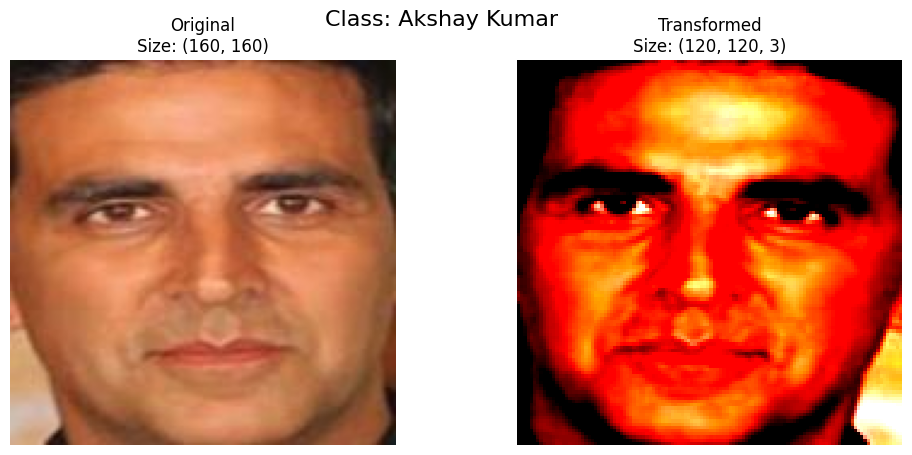

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..1.9577874].


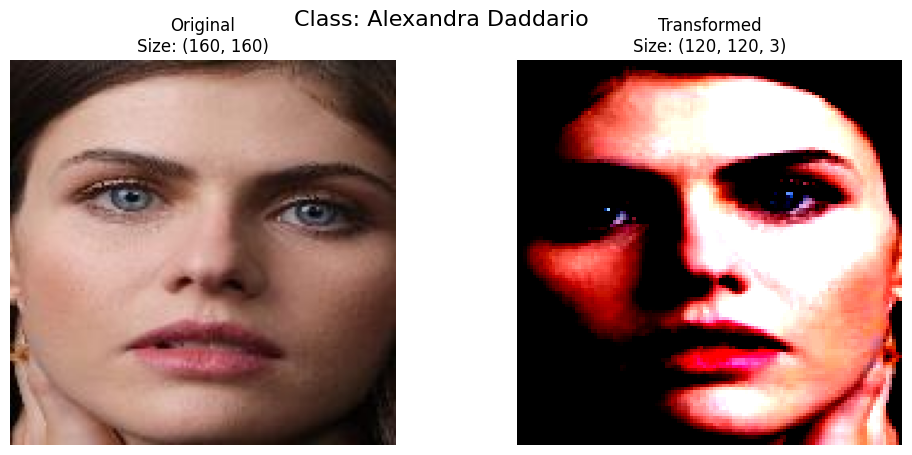

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.3262744].


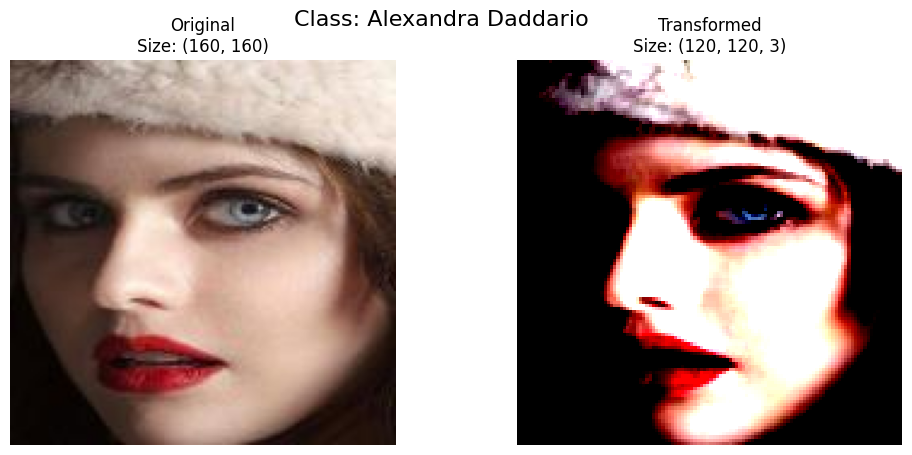

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1975338].


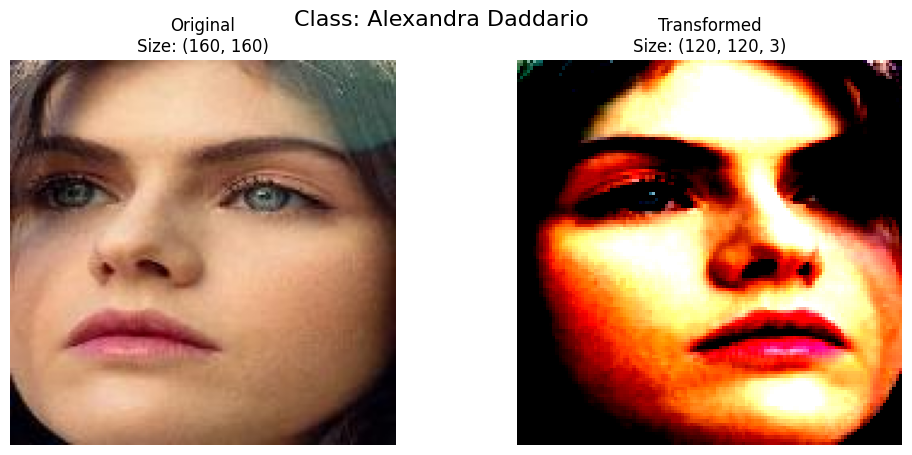

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.3785625].


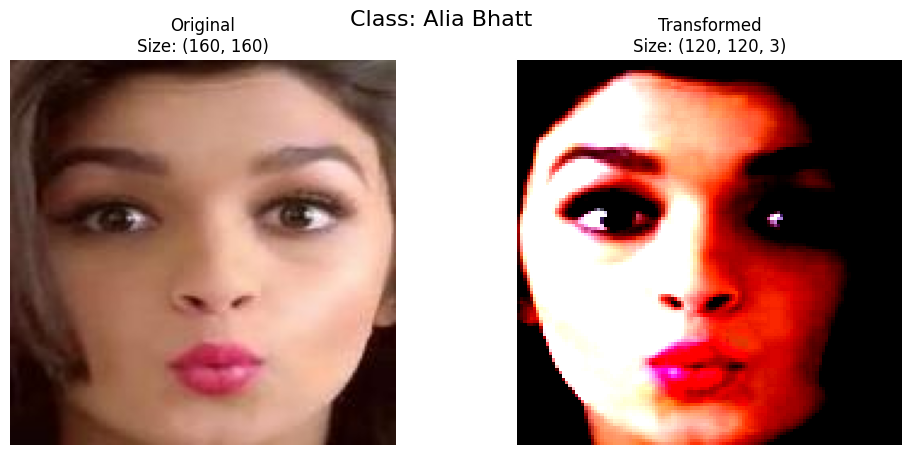

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


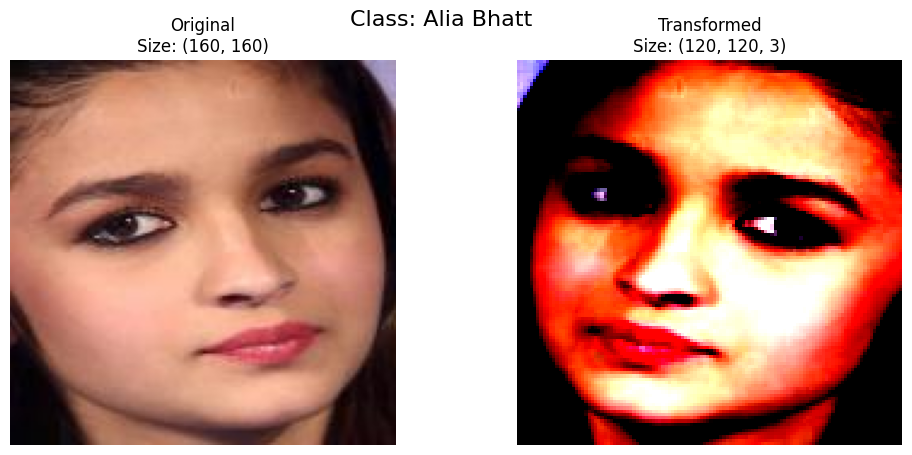

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.64].


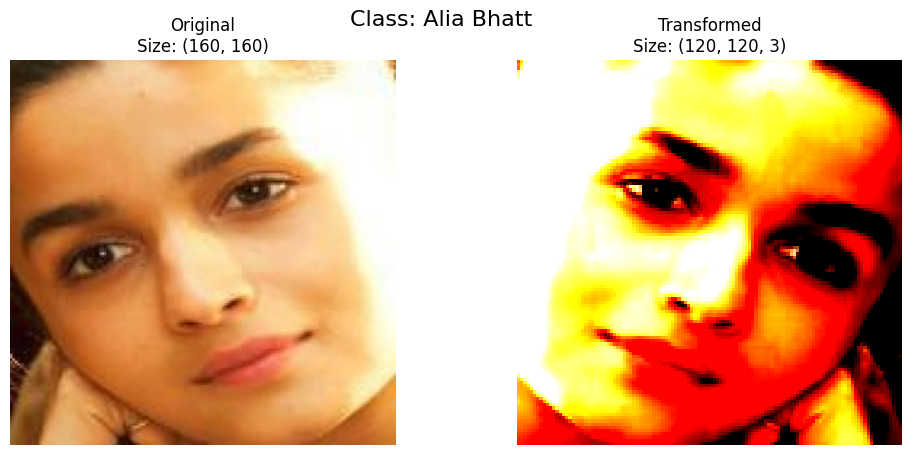

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


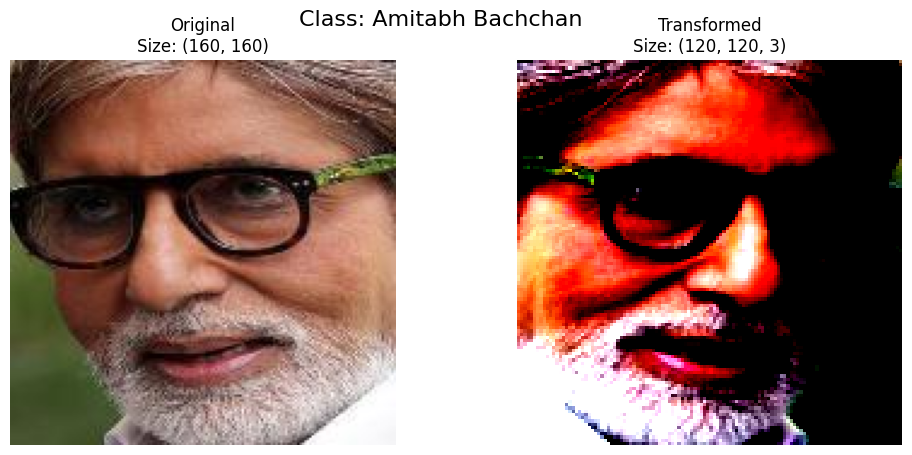

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


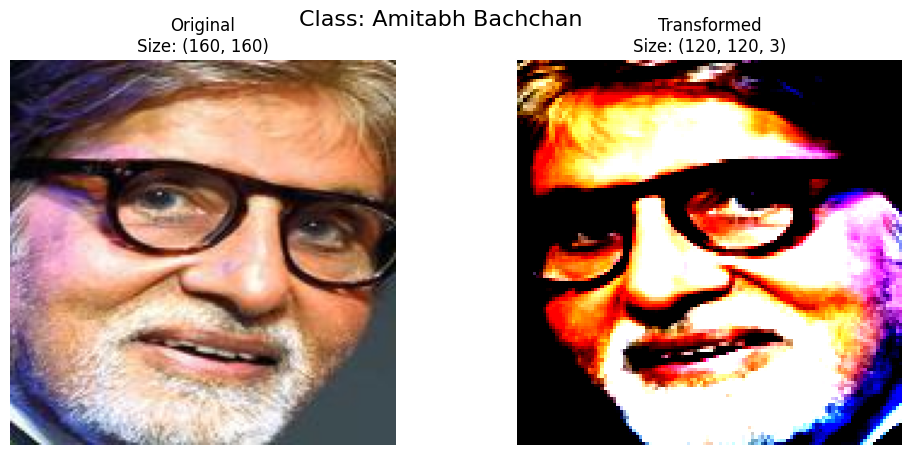

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


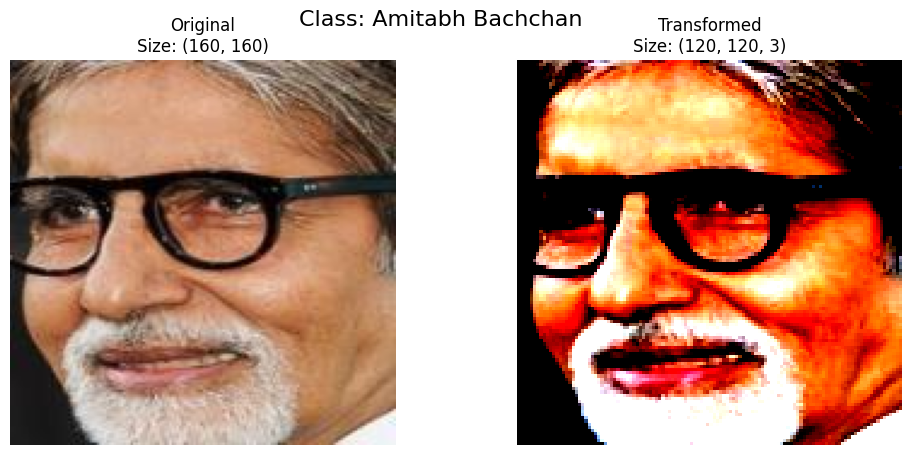

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.465708].


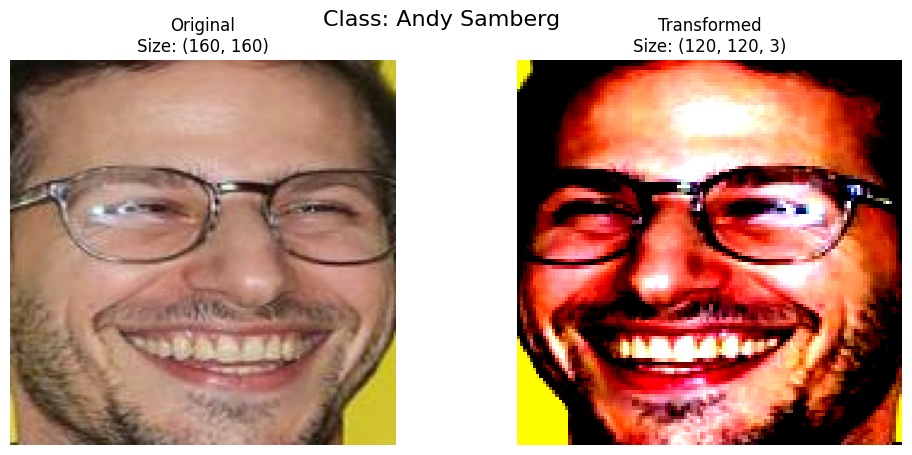

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9656862..1.6495419].


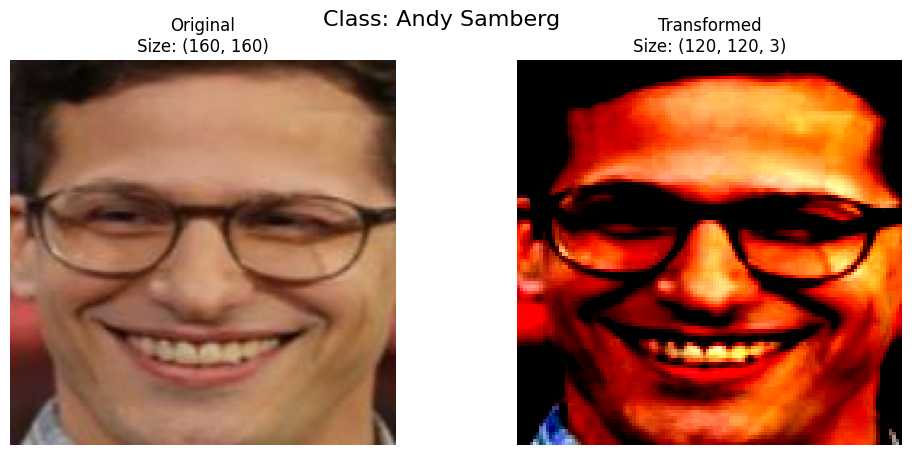

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].


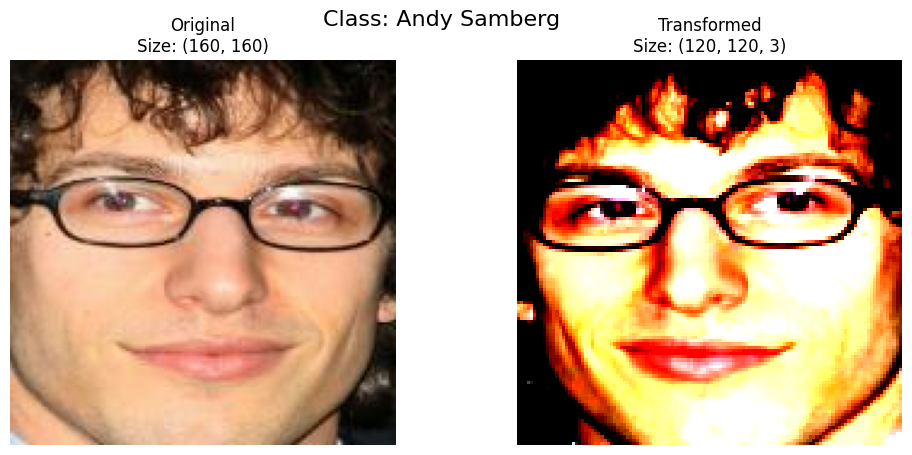

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].


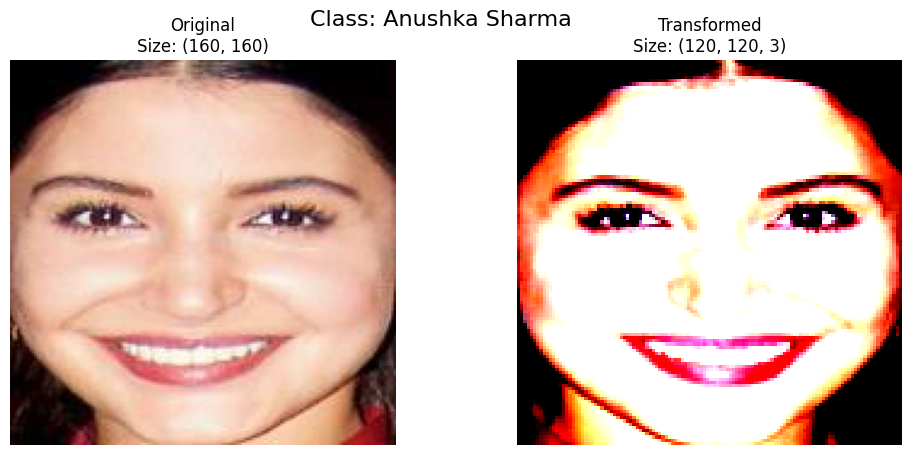

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


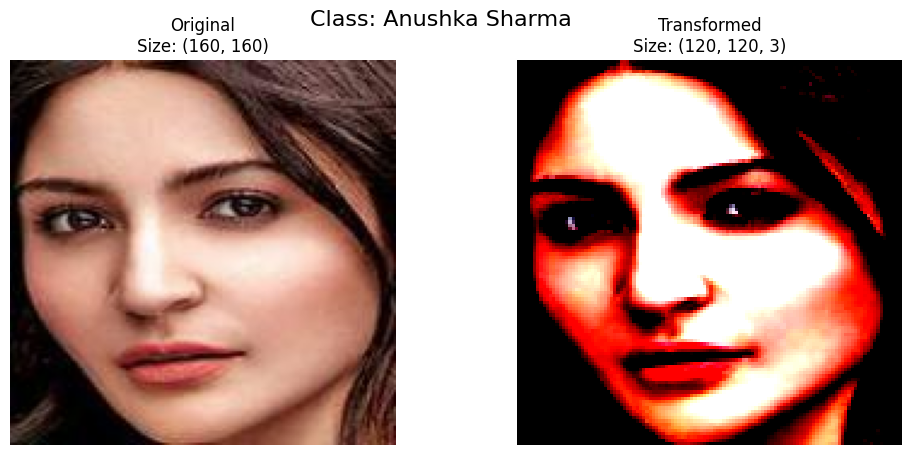

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6495419].


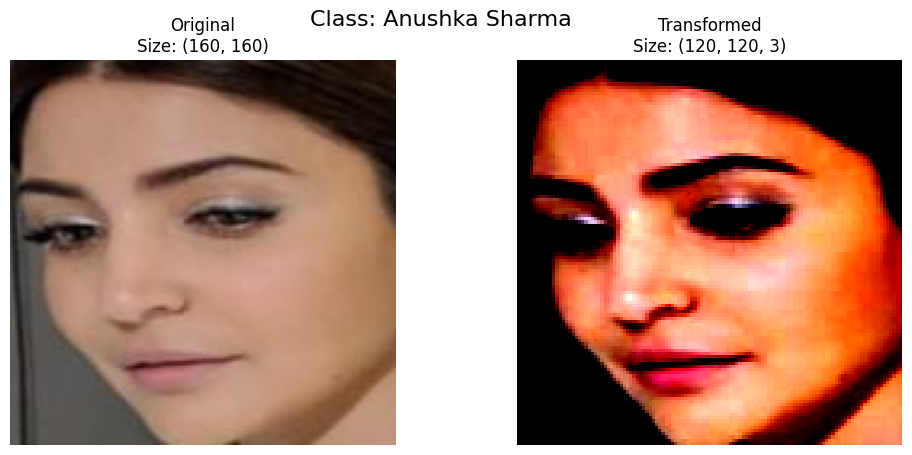

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].


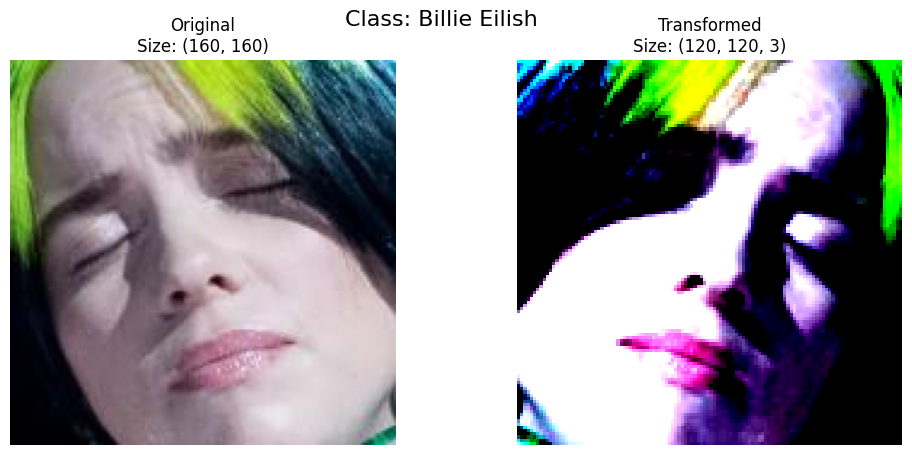

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9656862..2.64].


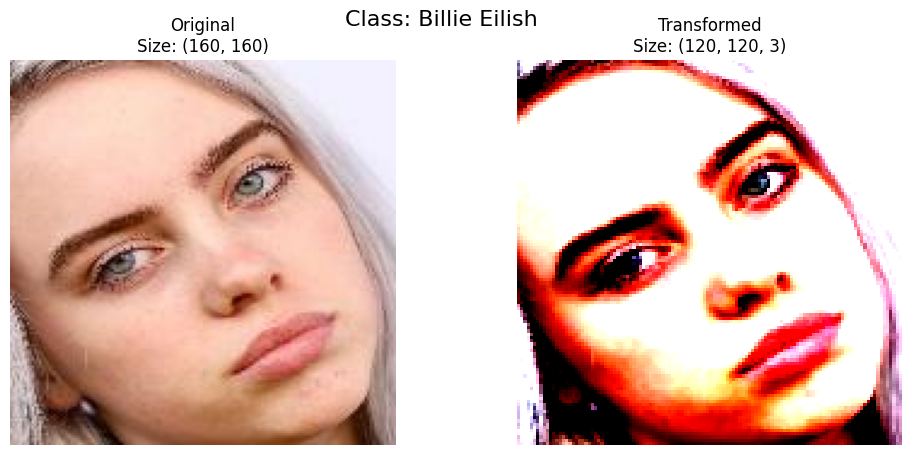

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.3785625].


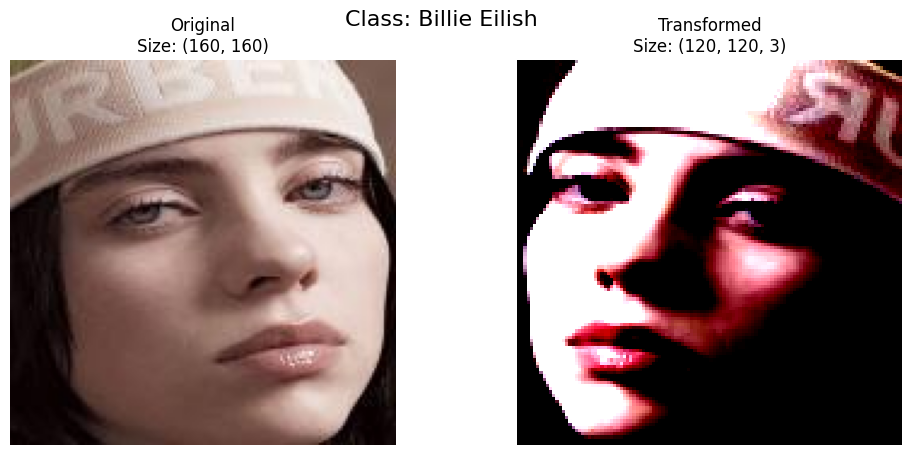

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8431373..2.64].


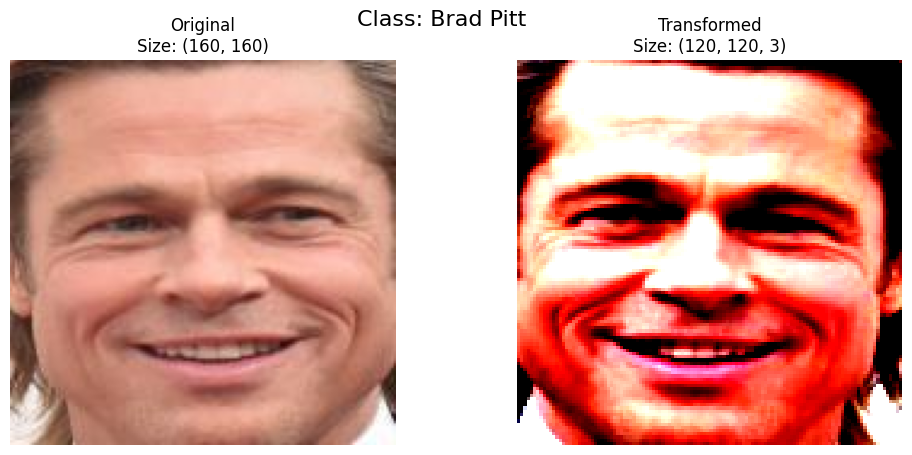

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.343704].


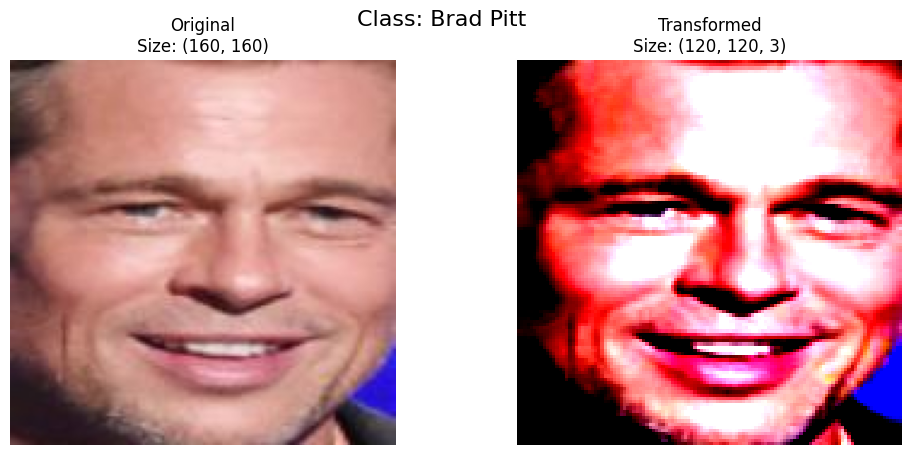

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.4308496].


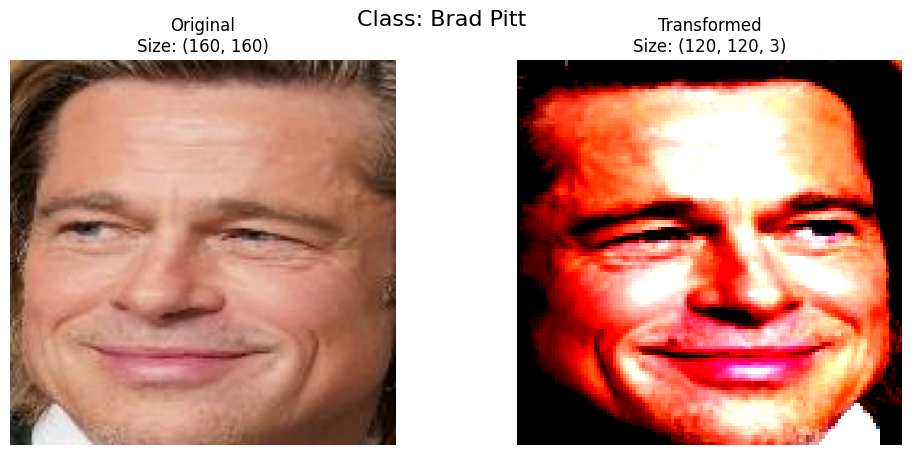

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.622571].


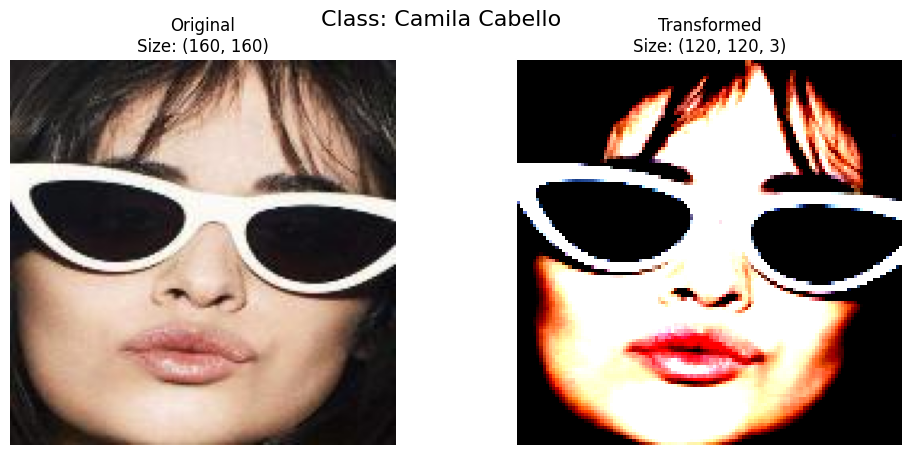

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


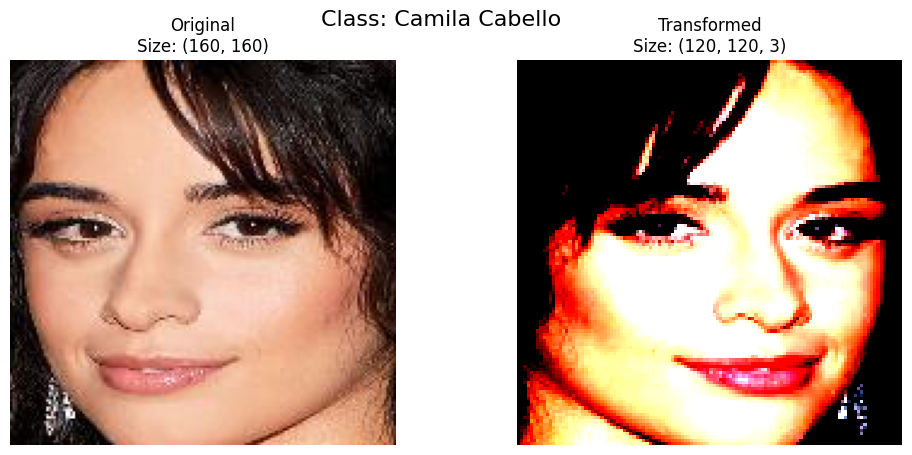

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5179958].


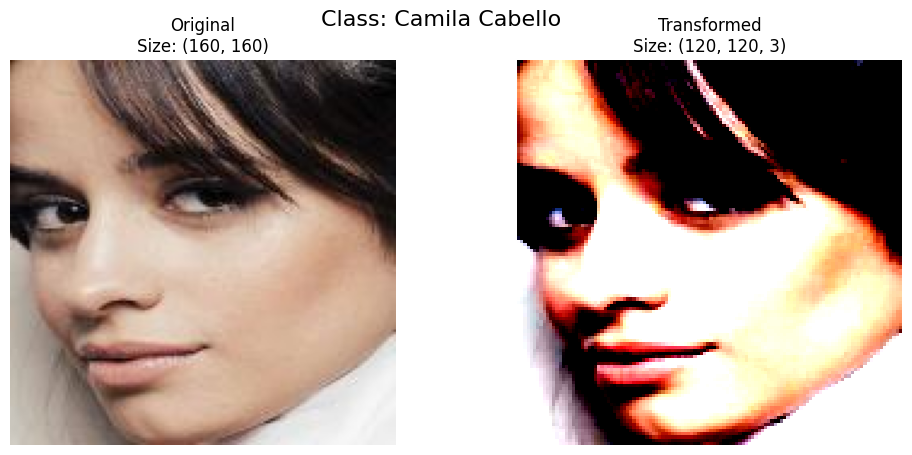

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7205882..2.0996952].


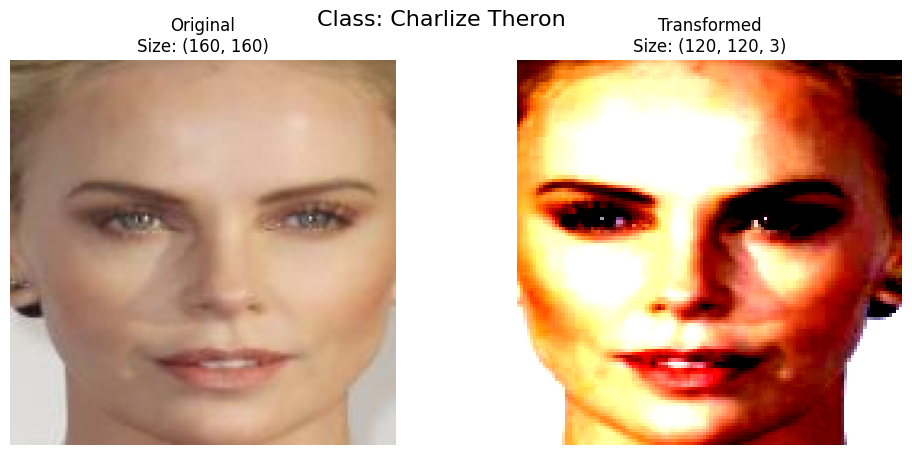

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.3088455].


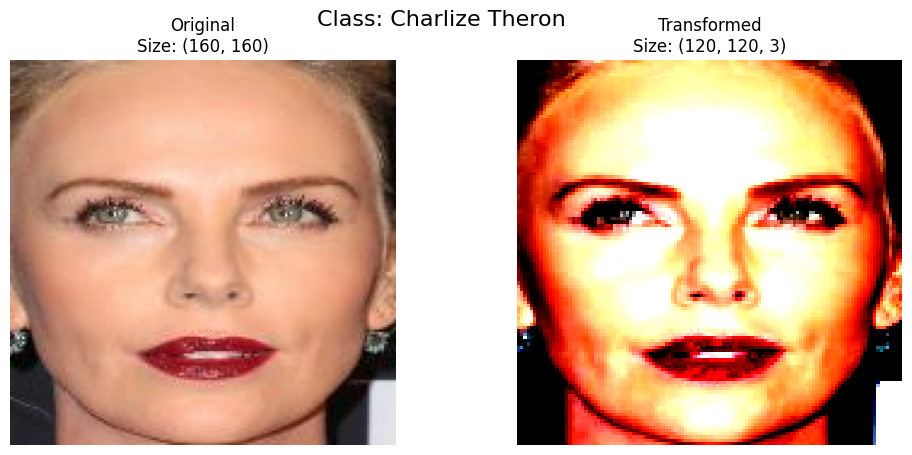

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.2489083].


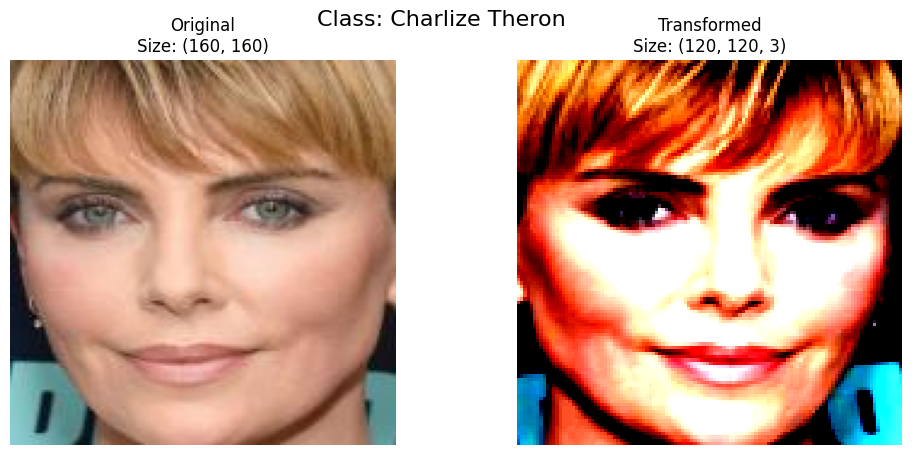

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.2914162].


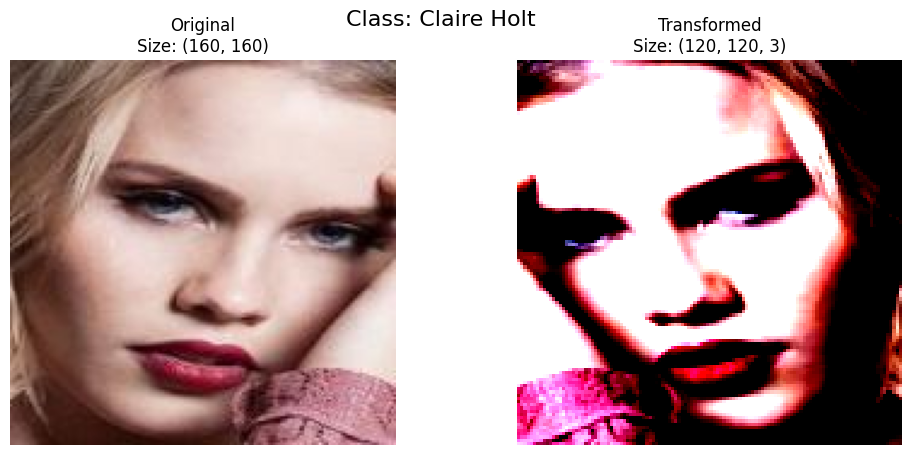

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9656862..2.3585434].


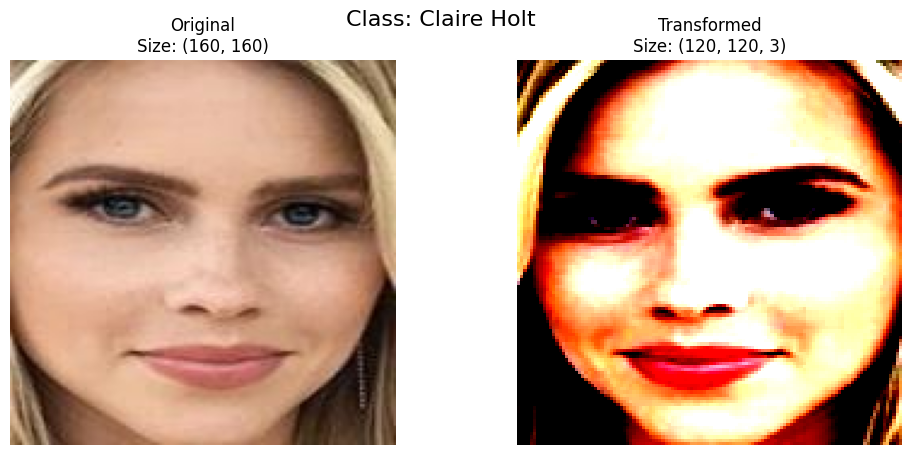

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8606442..2.1975338].


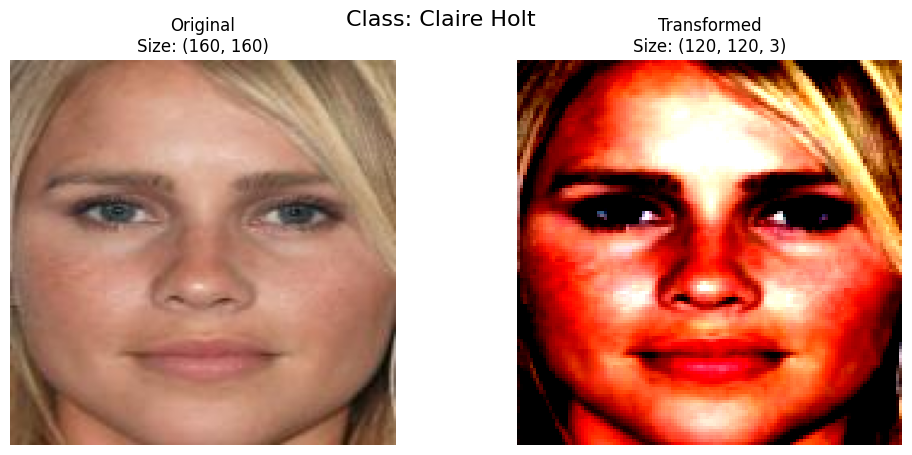

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..1.7865399].


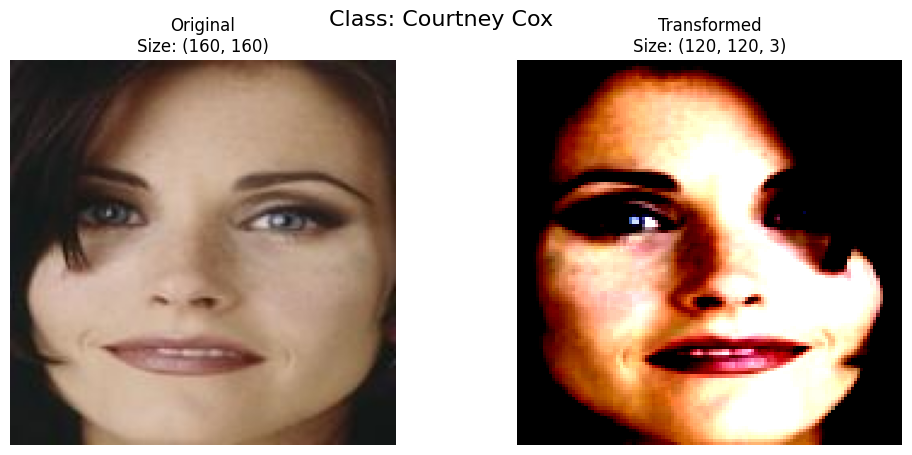

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


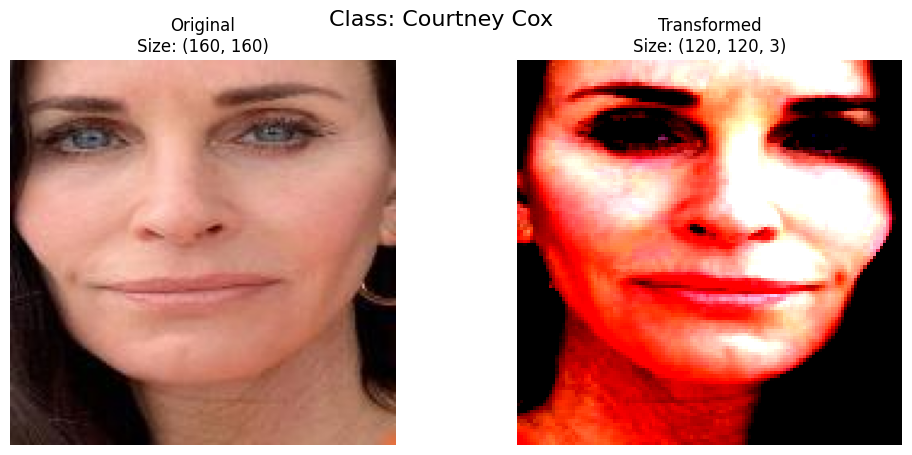

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2489083].


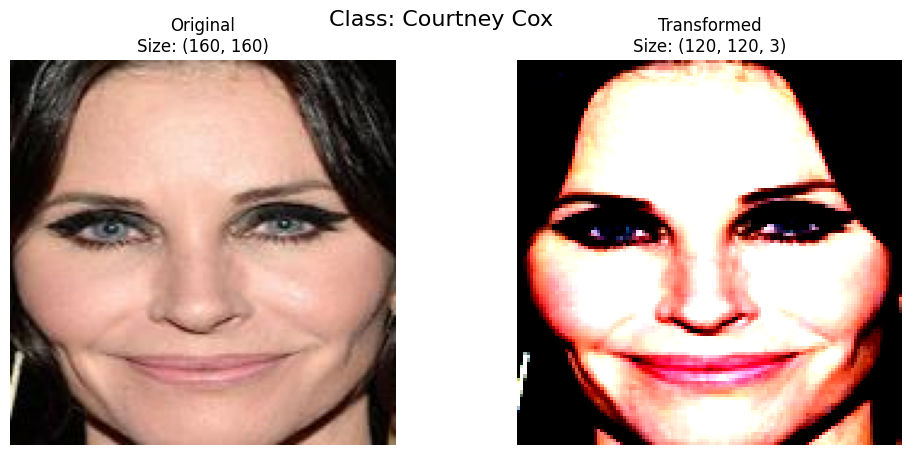

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6726604..2.3088455].


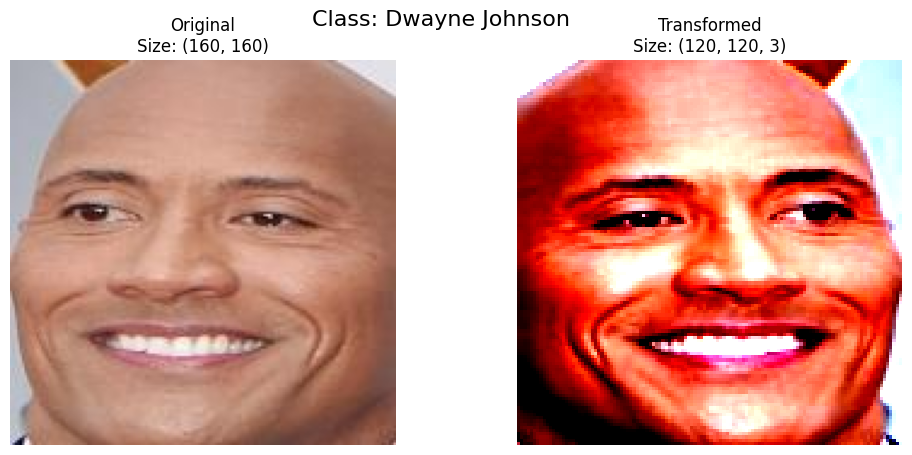

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7030813..2.64].


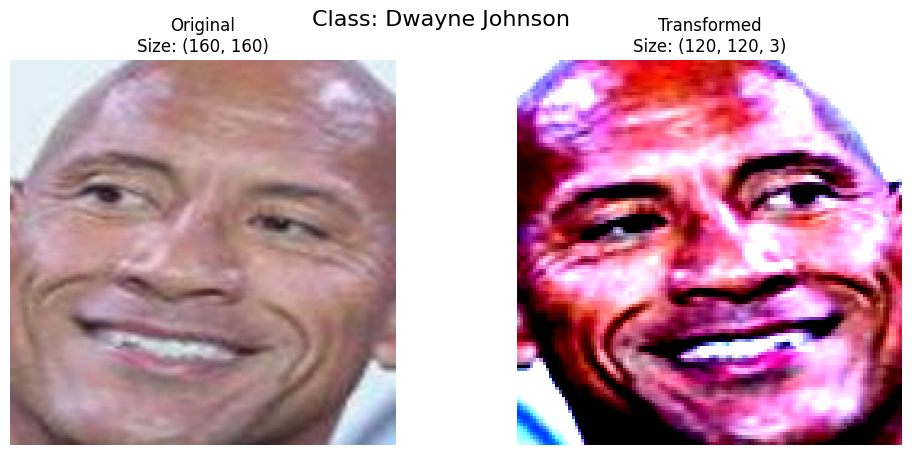

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].


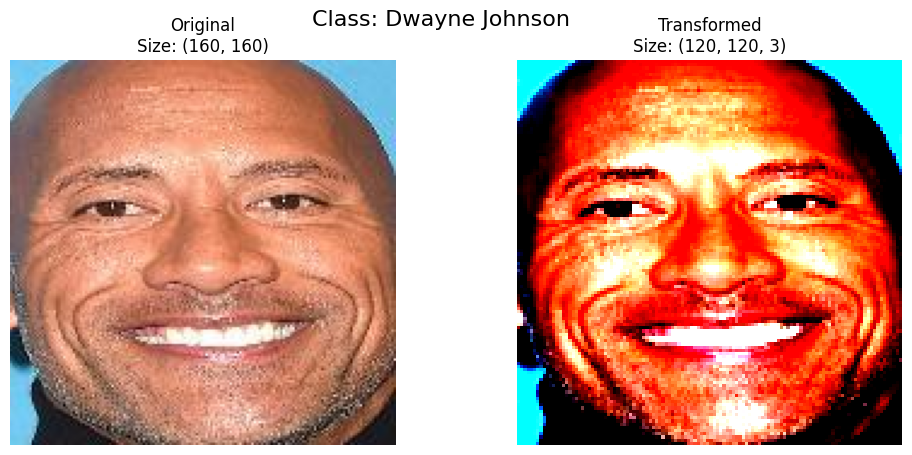

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9131652..2.0776608].


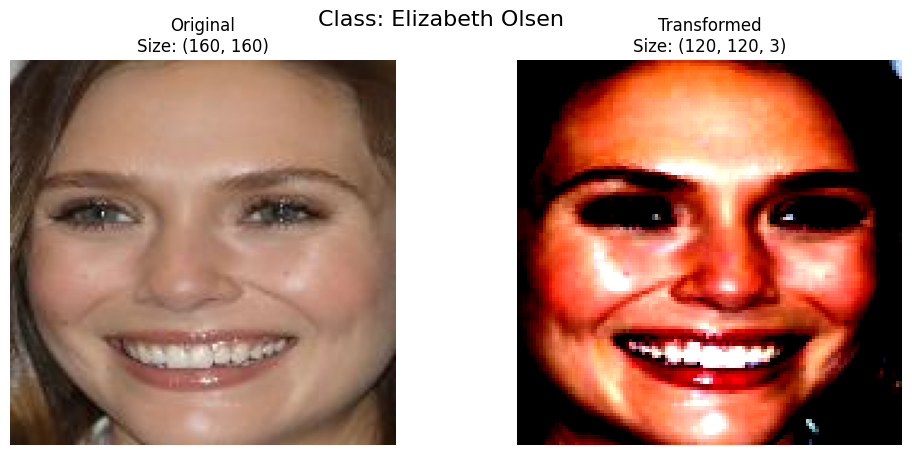

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


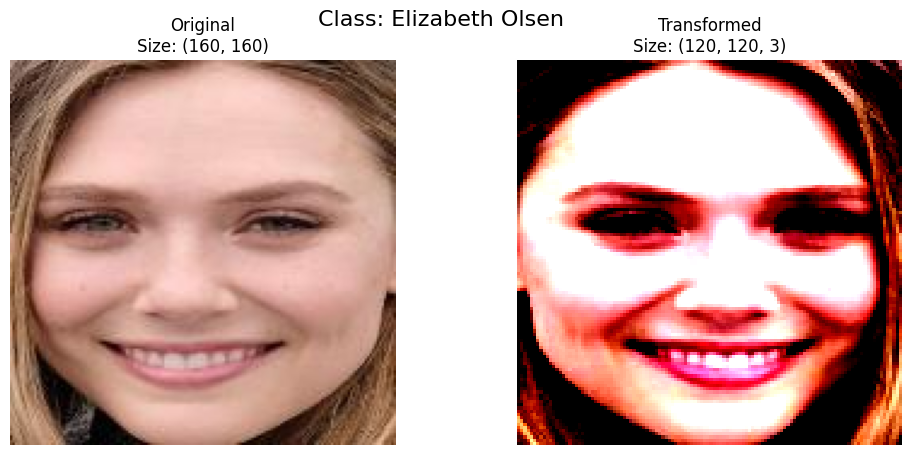

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.923538].


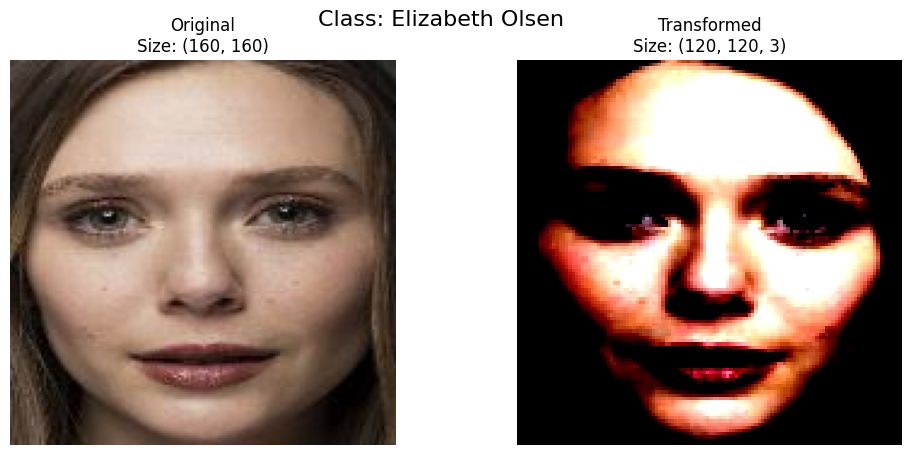

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6855742..2.64].


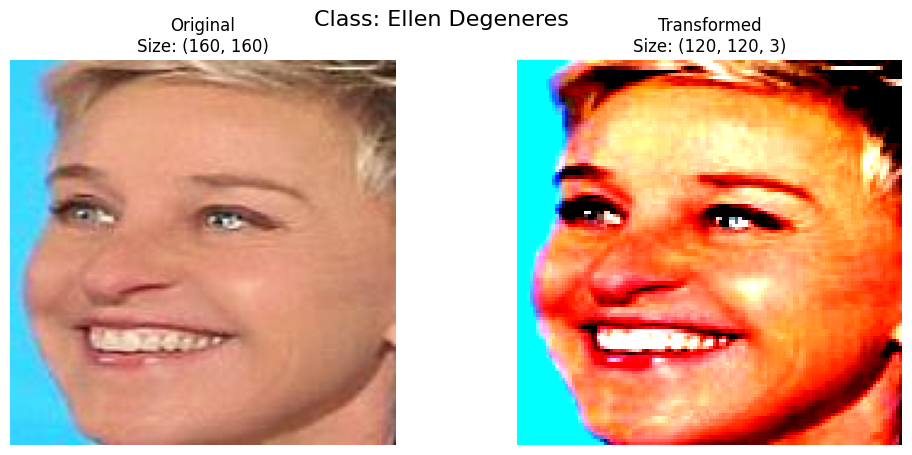

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.2317834].


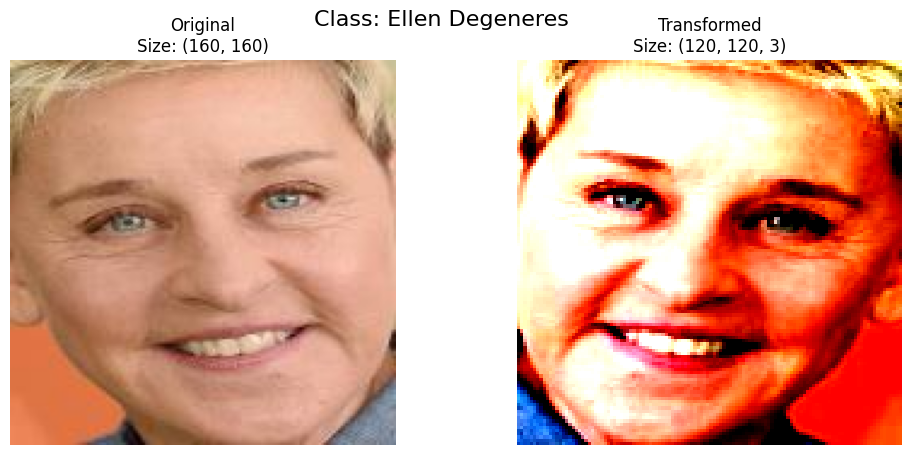

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.3611329].


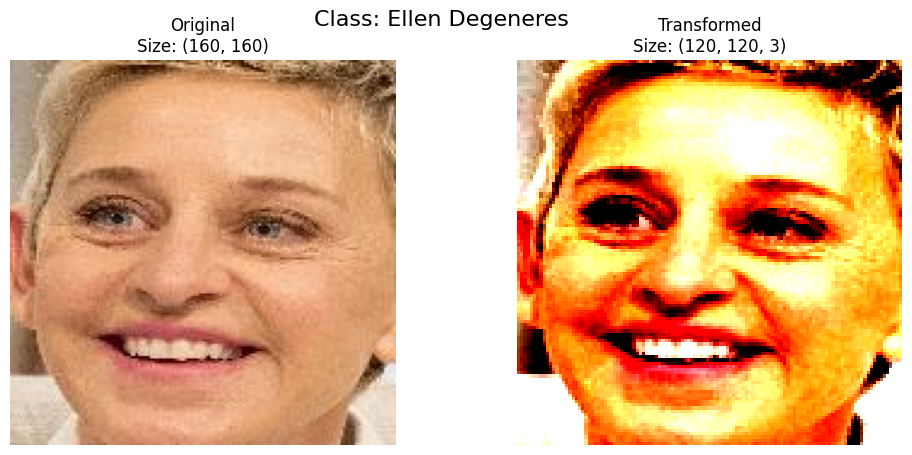

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..1.9577874].


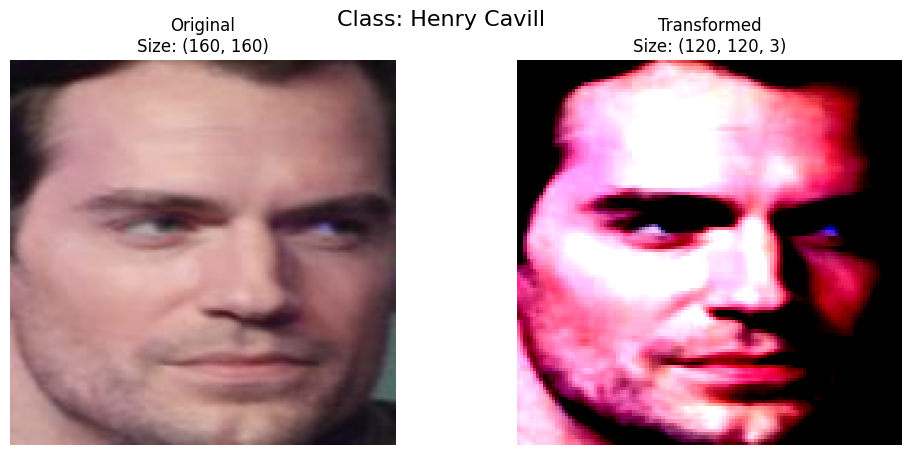

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9831933..1.8036647].


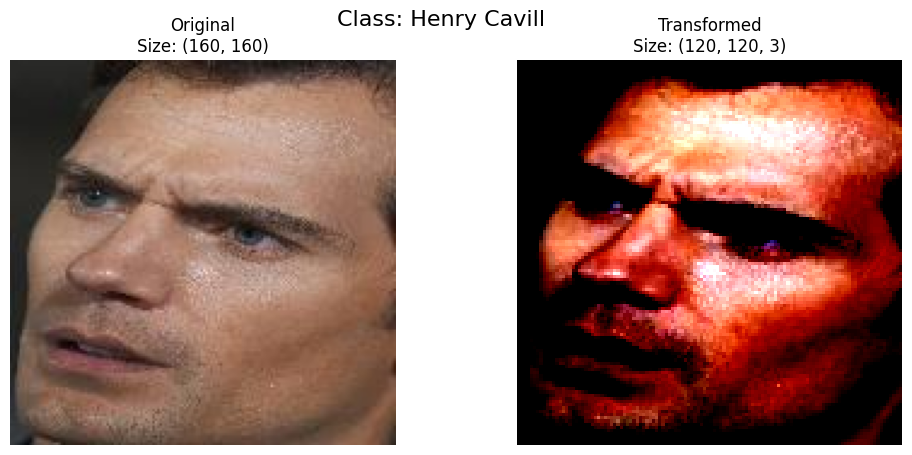

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.2489083].


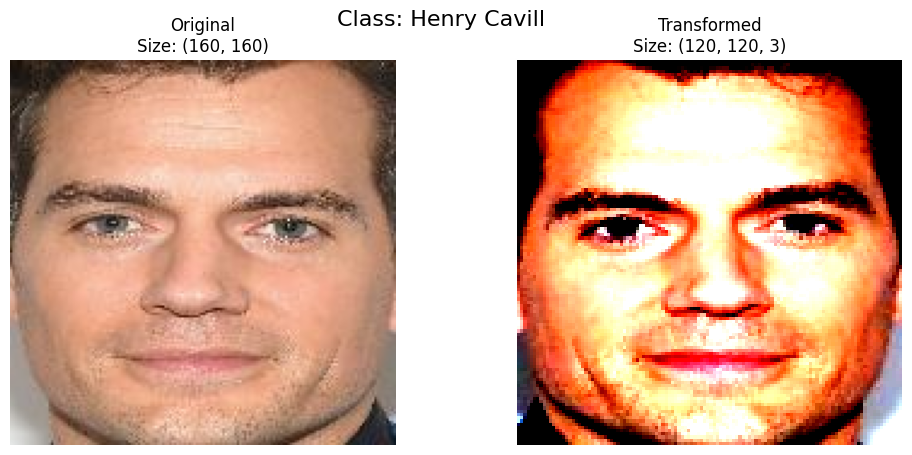

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..1.8207895].


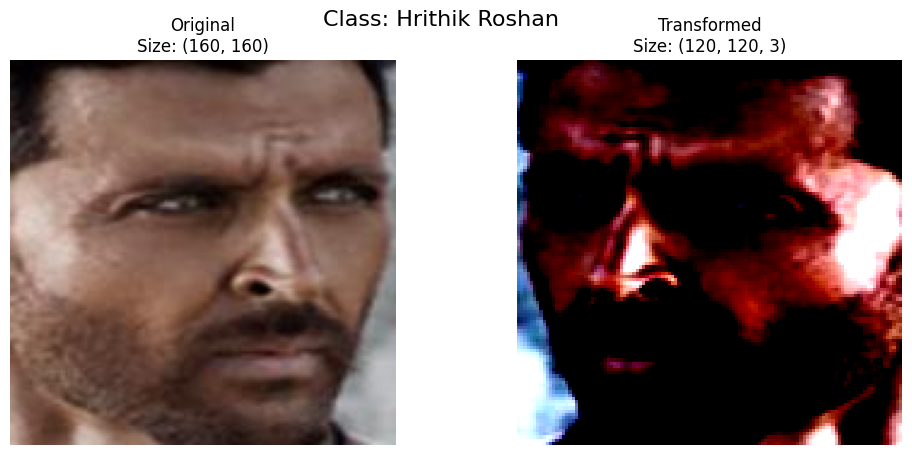

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7380952..2.465708].


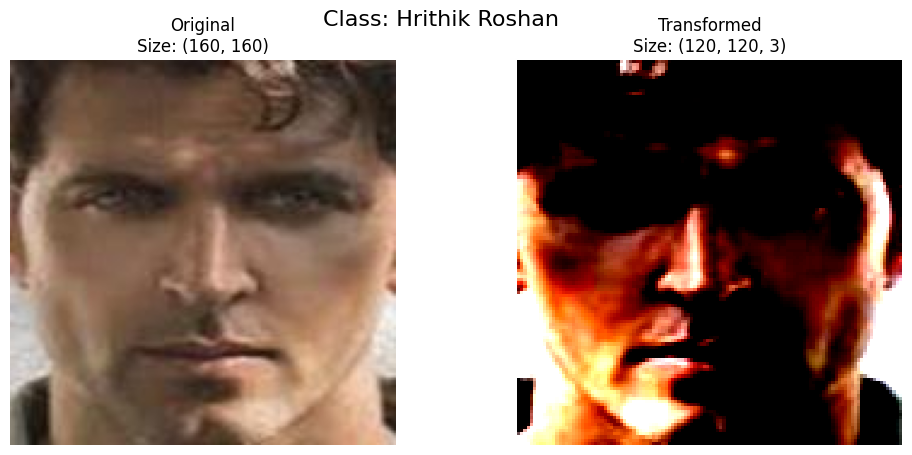

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.64].


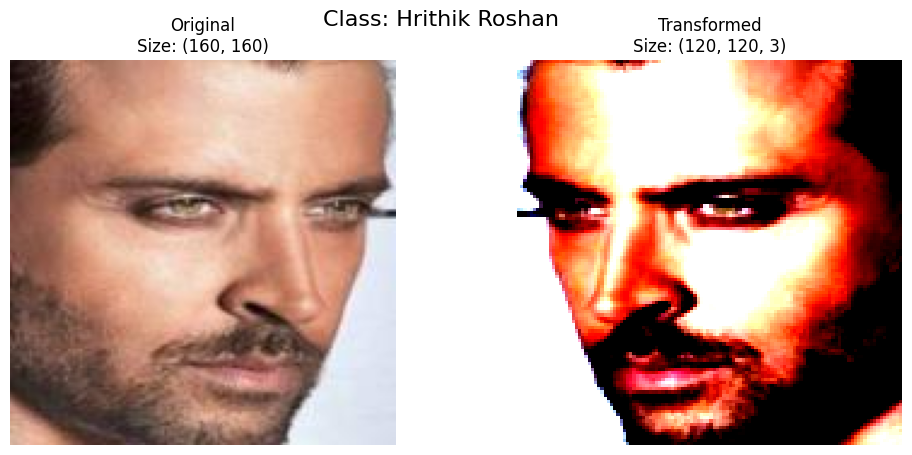

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].


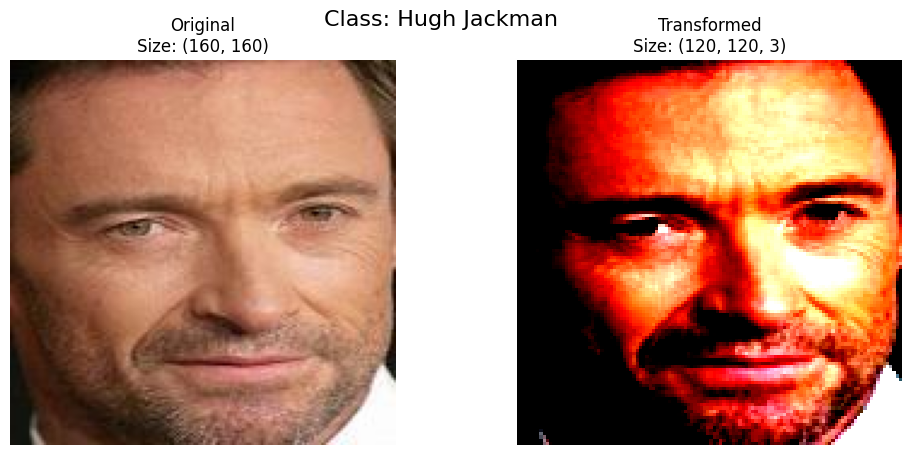

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.64].


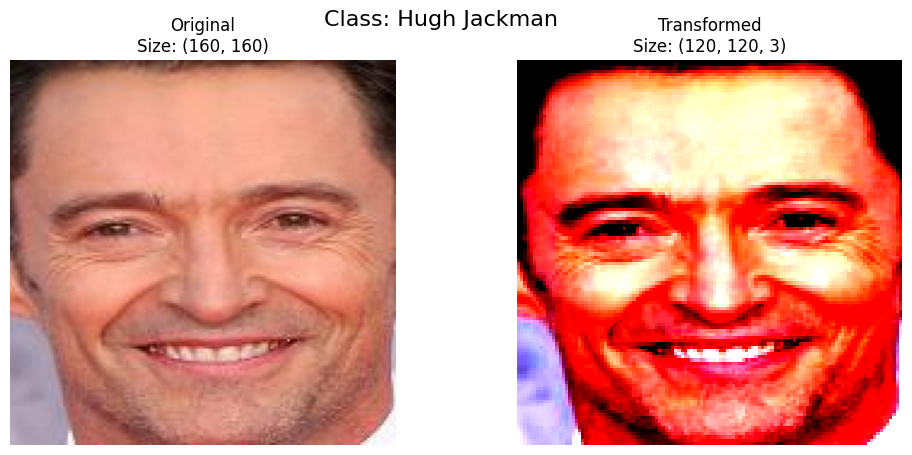

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


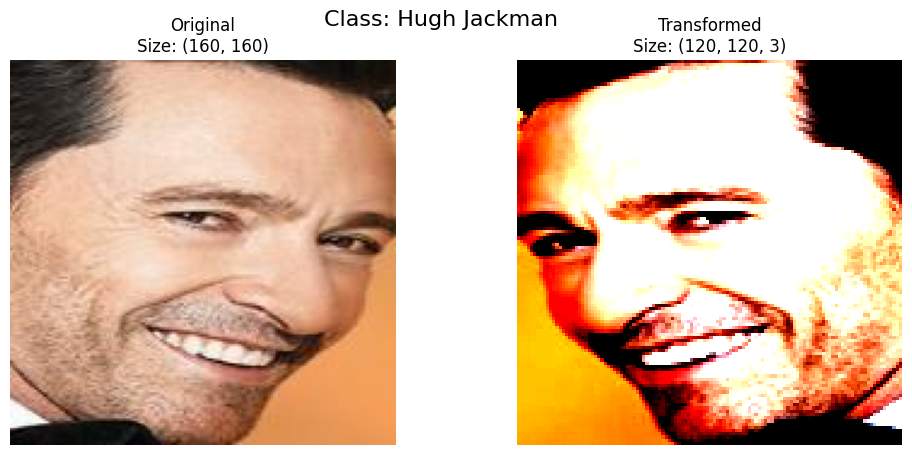

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.1975338].


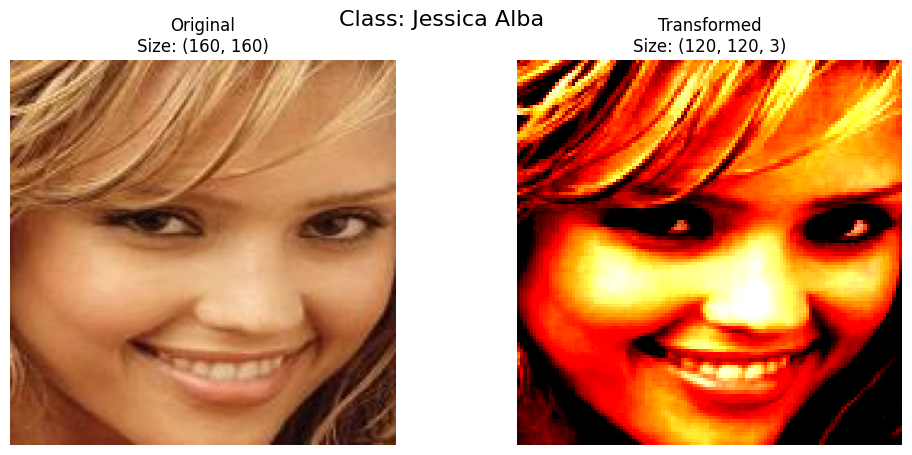

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..2.1632845].


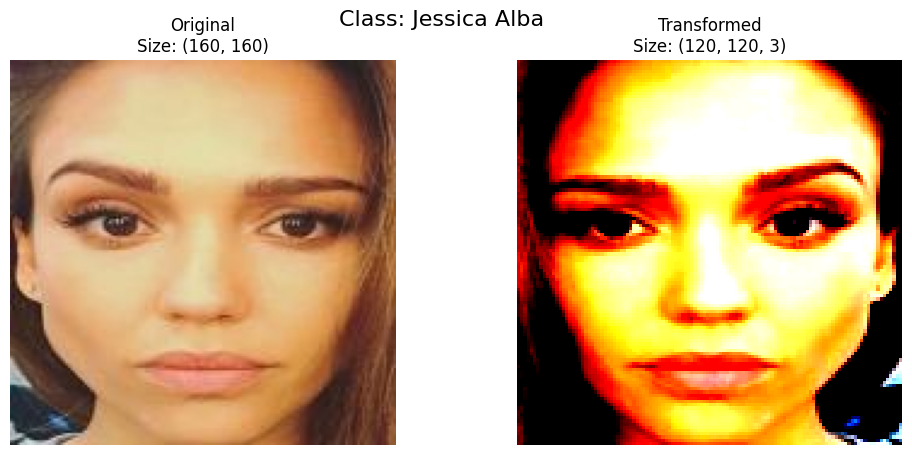

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


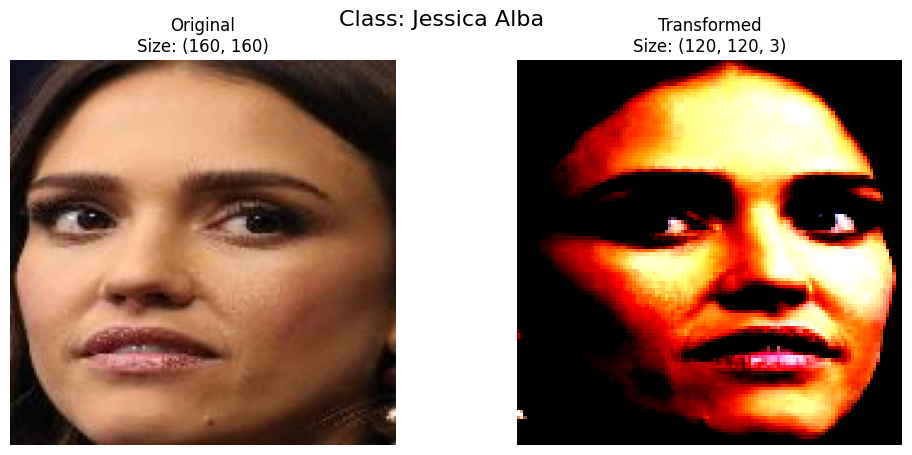

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5179958].


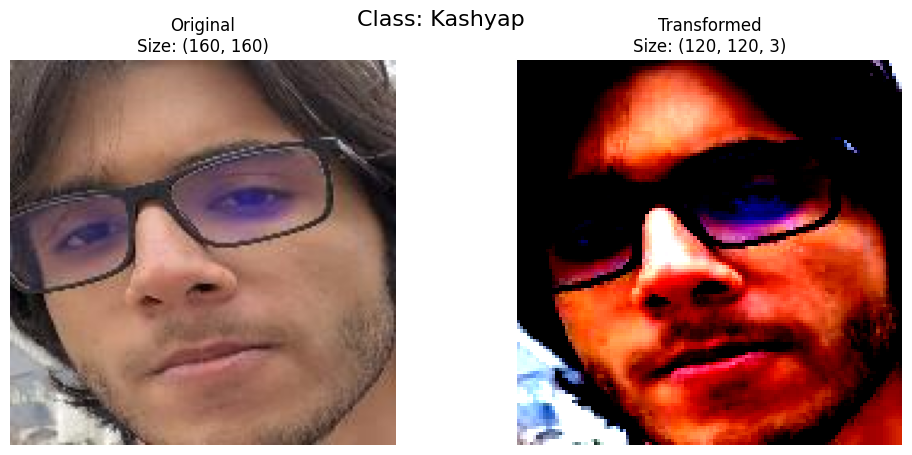

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.1975338].


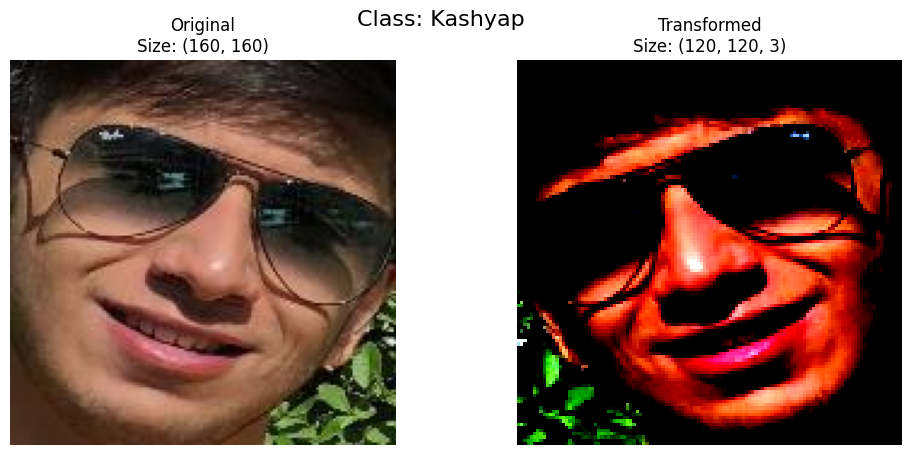

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].


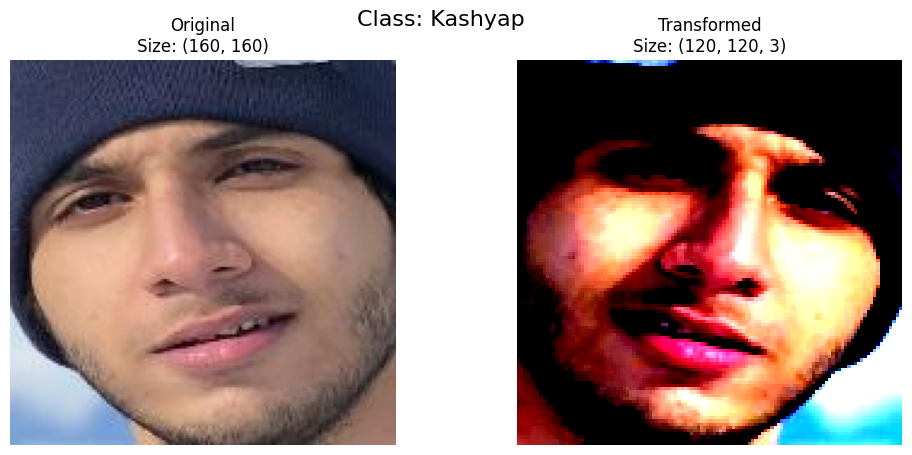

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8256302..2.2317834].


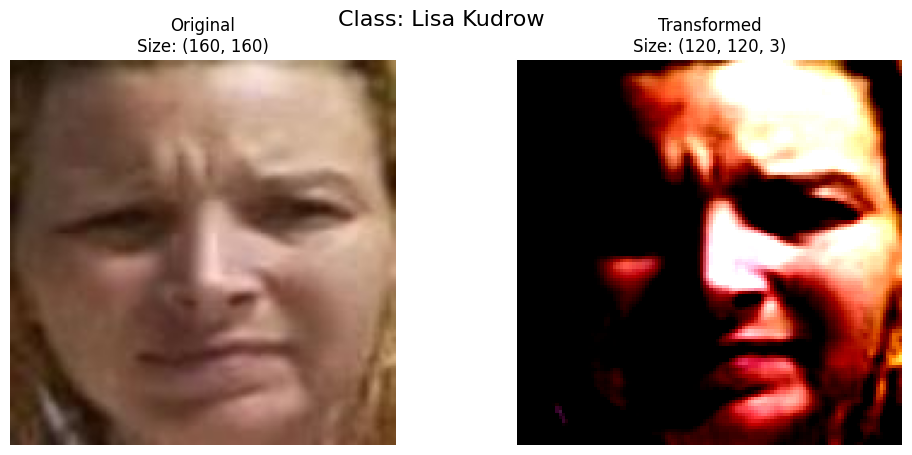

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8956583..2.0262864].


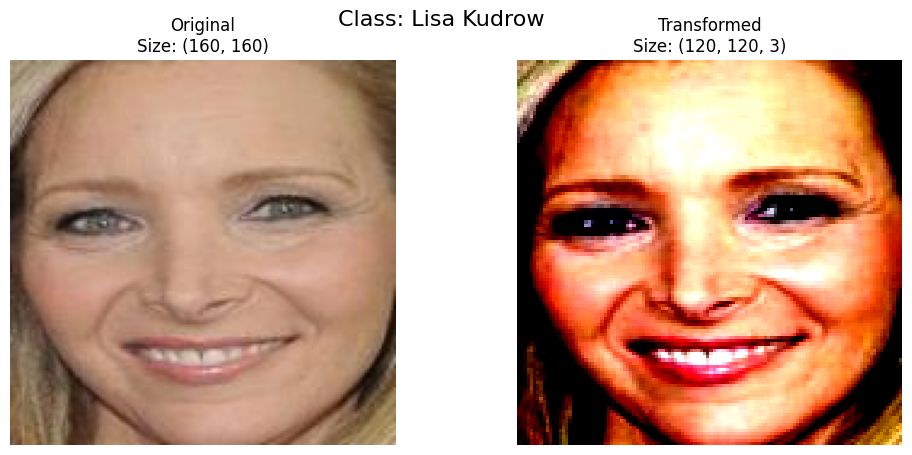

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..1.8036647].


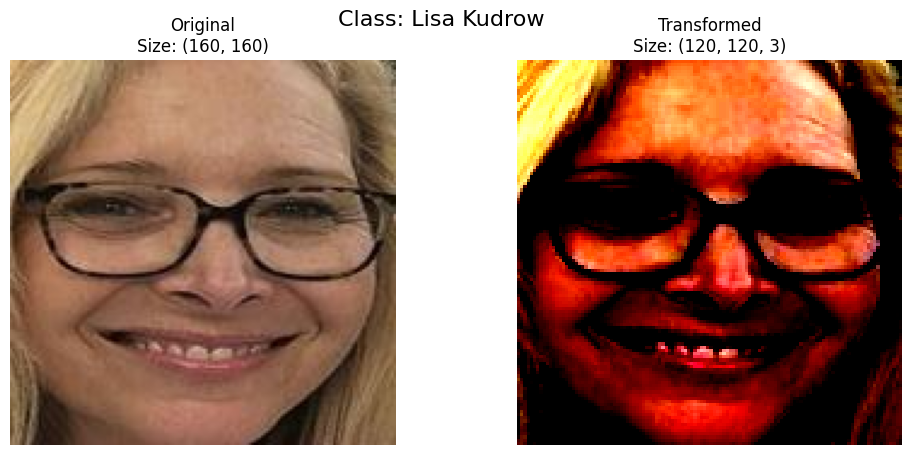

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8081232..2.2489083].


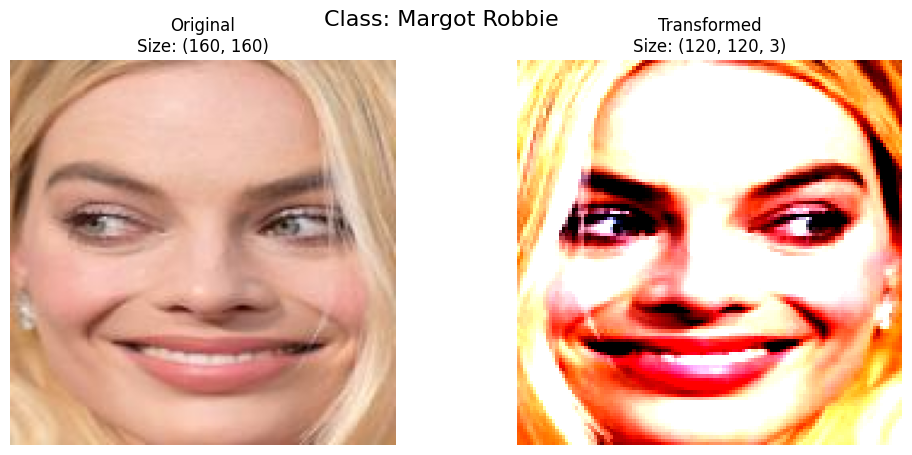

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.2489083].


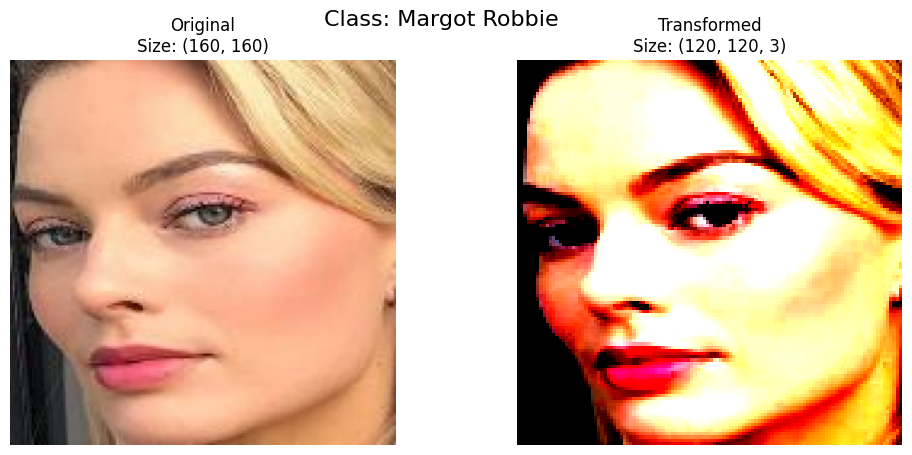

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9831933..2.1461596].


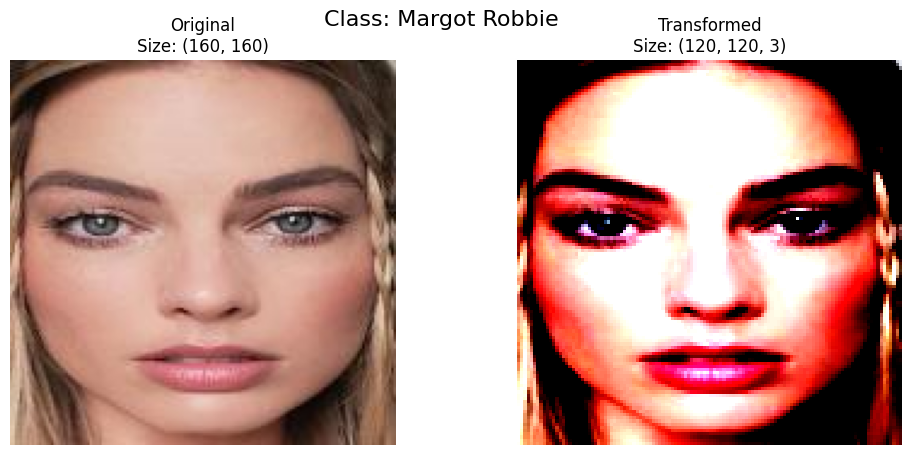

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.2489083].


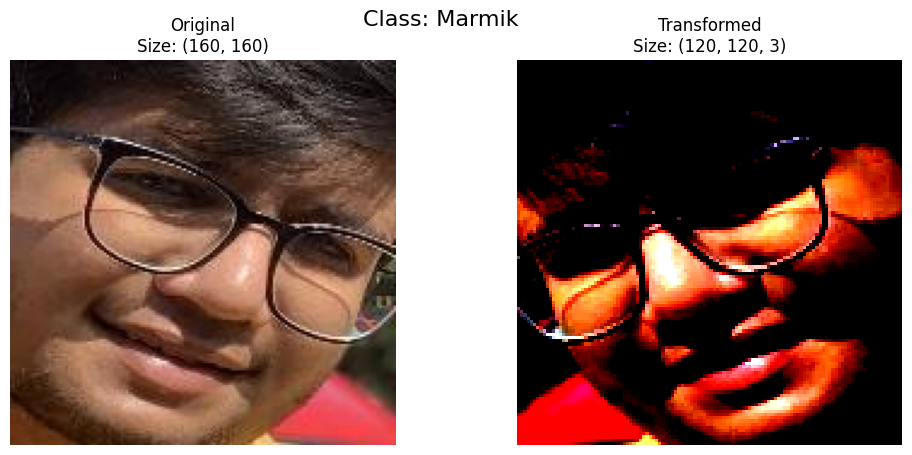

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7731092..2.1345534].


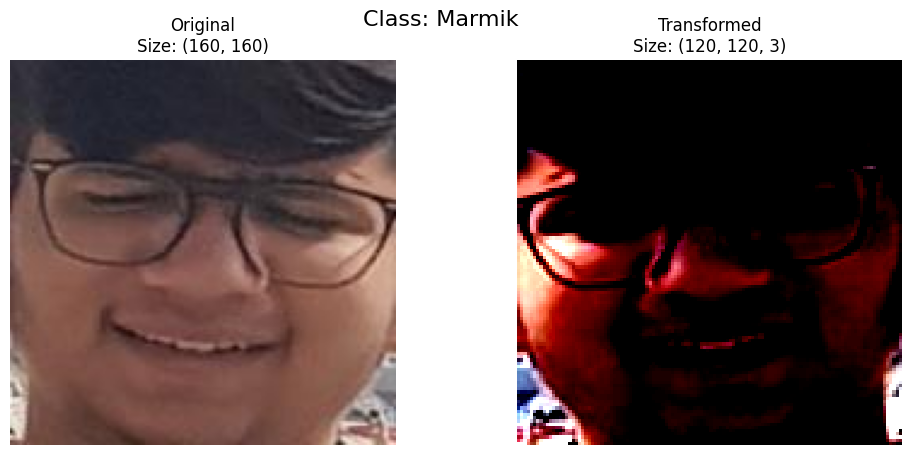

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


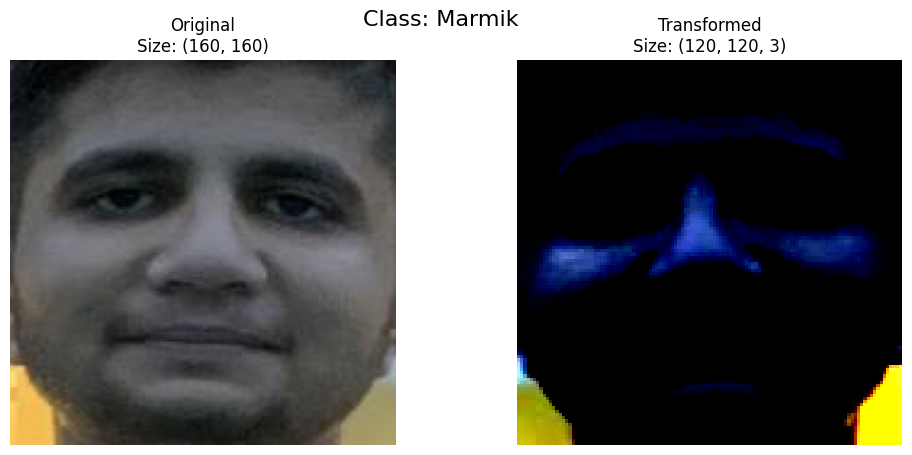

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..2.3088455].


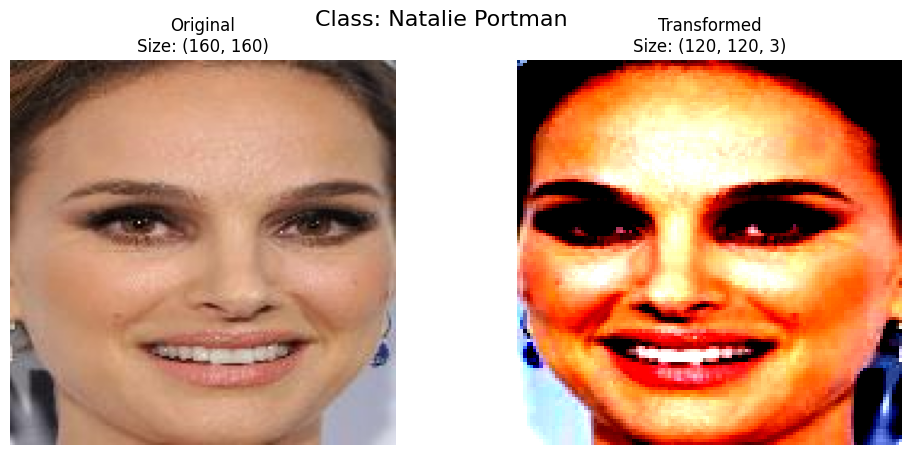

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..1.8892884].


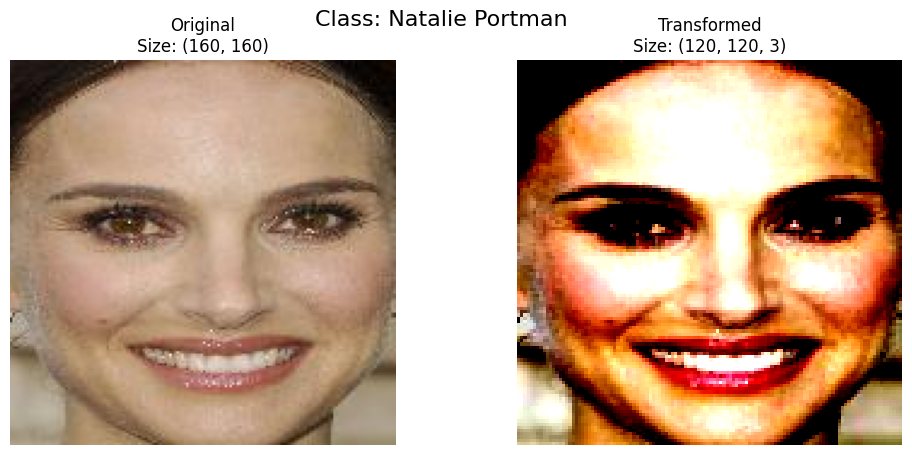

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7556022..2.5179958].


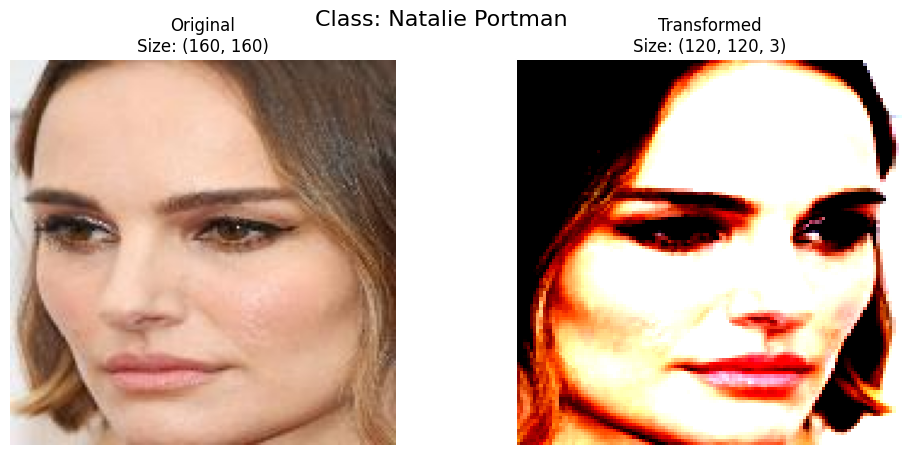

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.4134207].


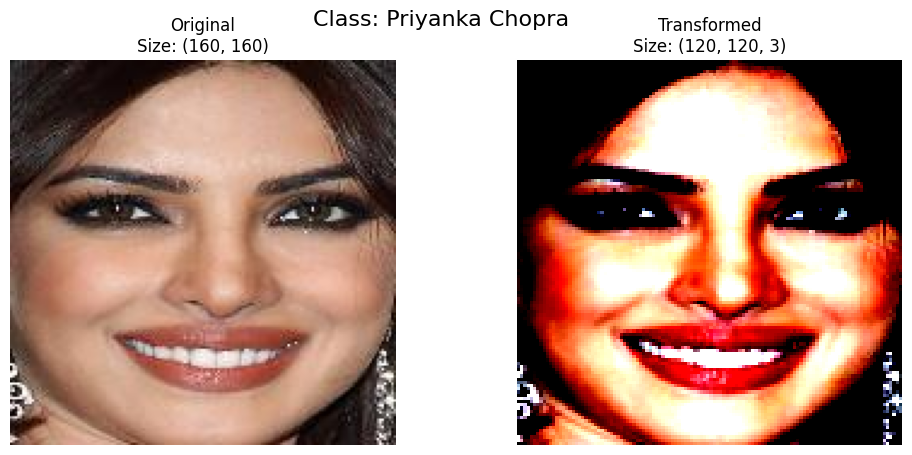

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].


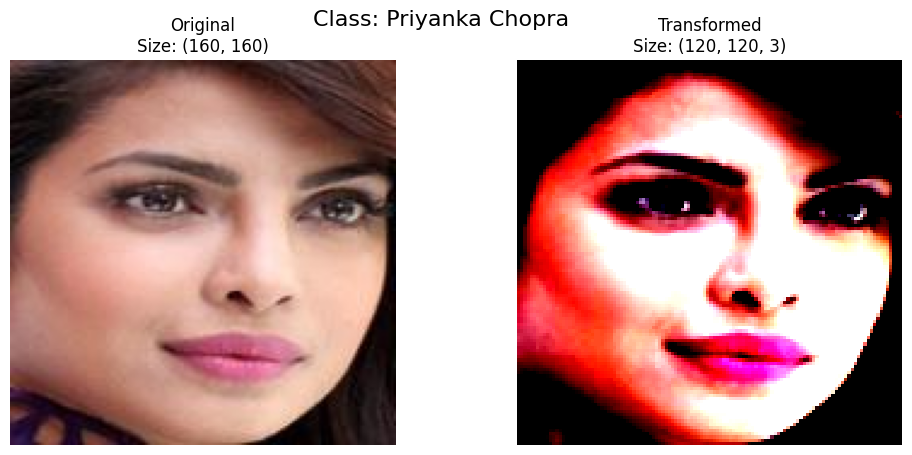

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1632845].


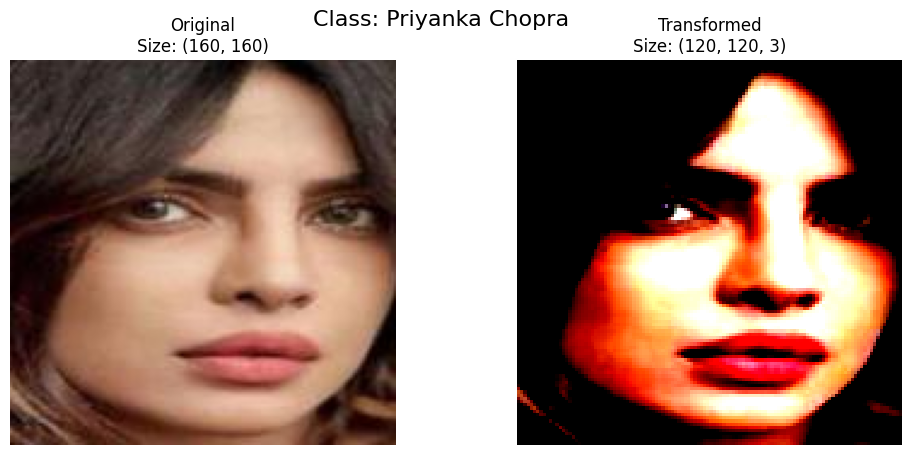

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


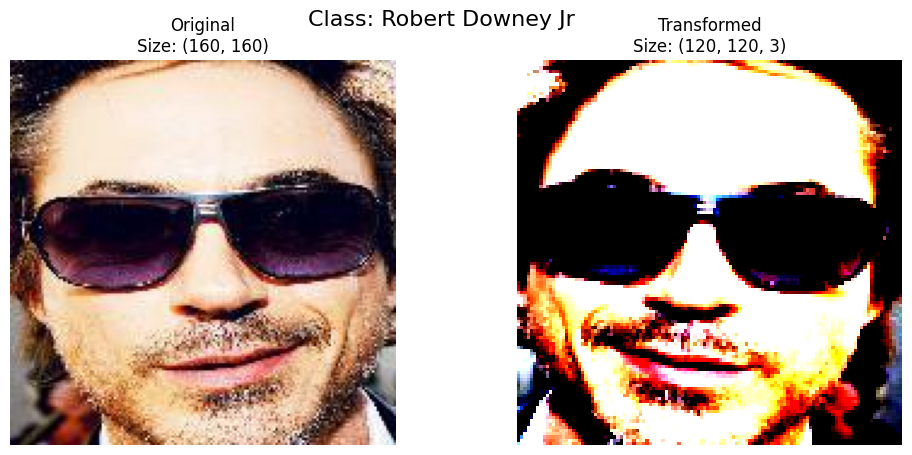

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].


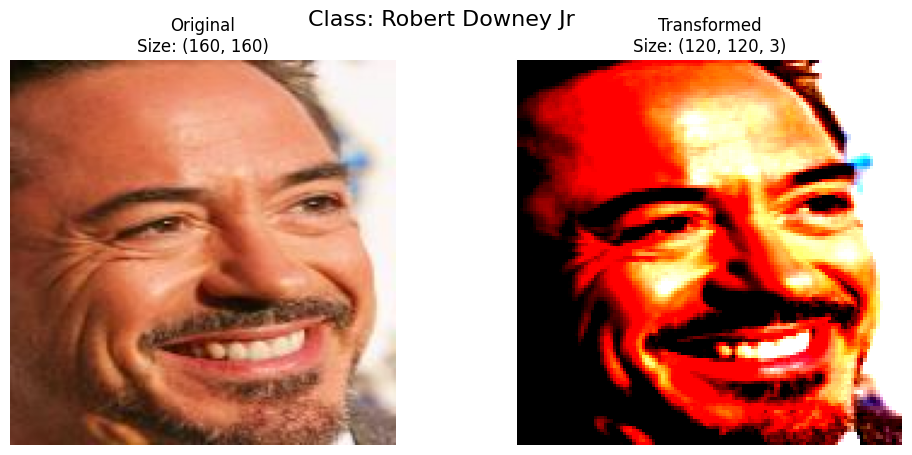

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.2146587].


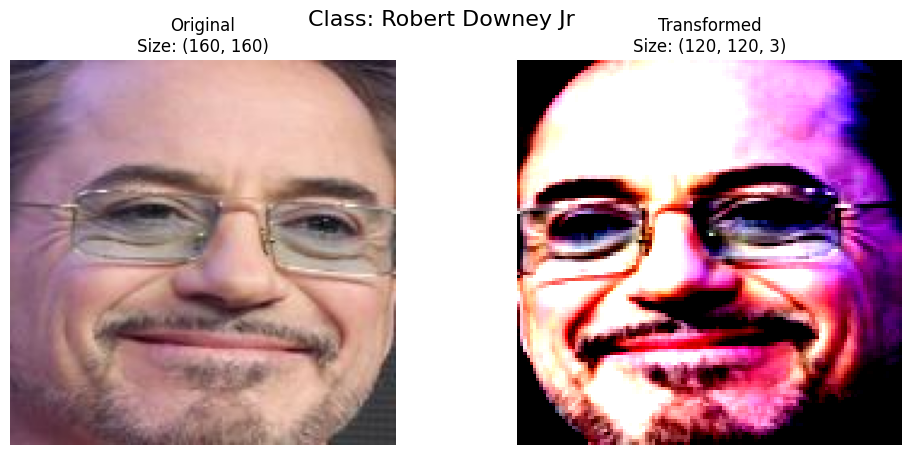

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


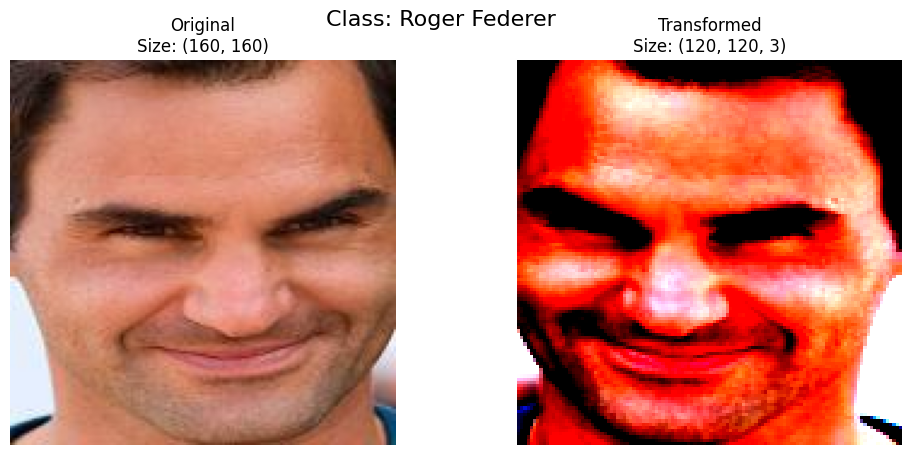

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2146587].


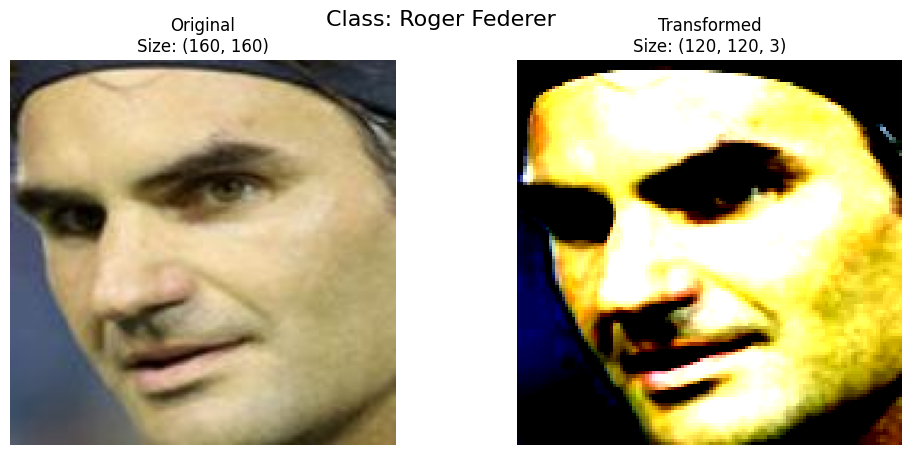

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.64].


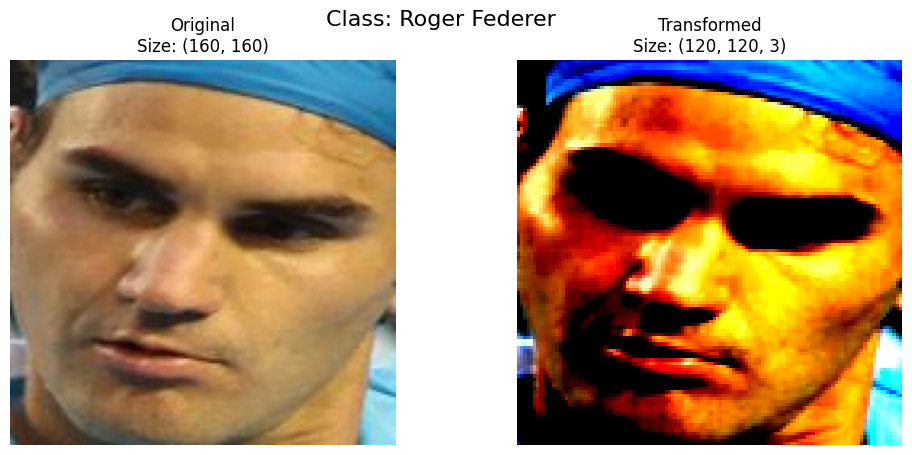

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7906162..2.2914162].


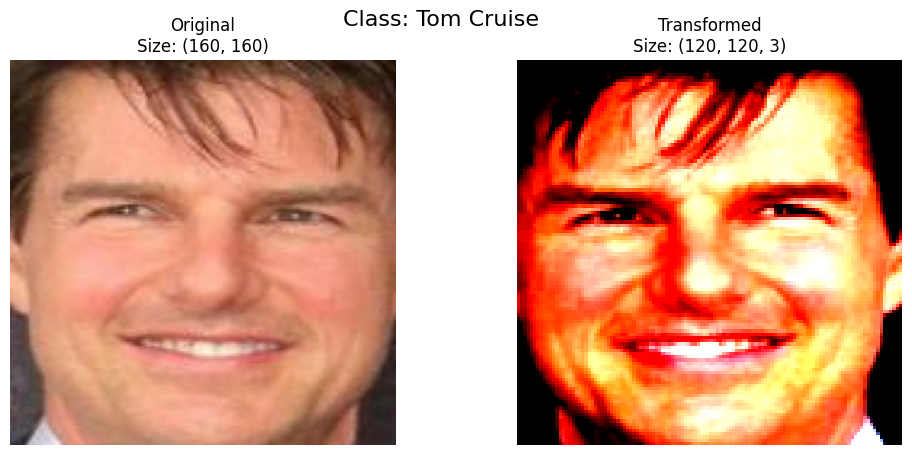

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.2489083].


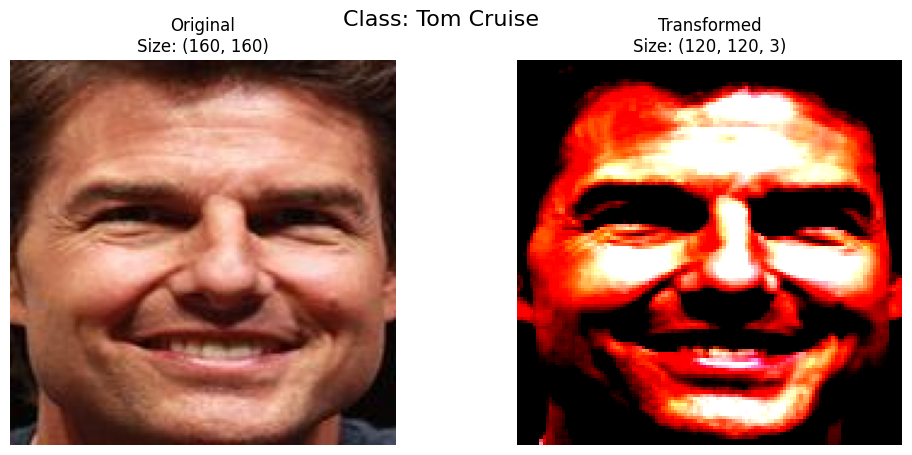

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.622571].


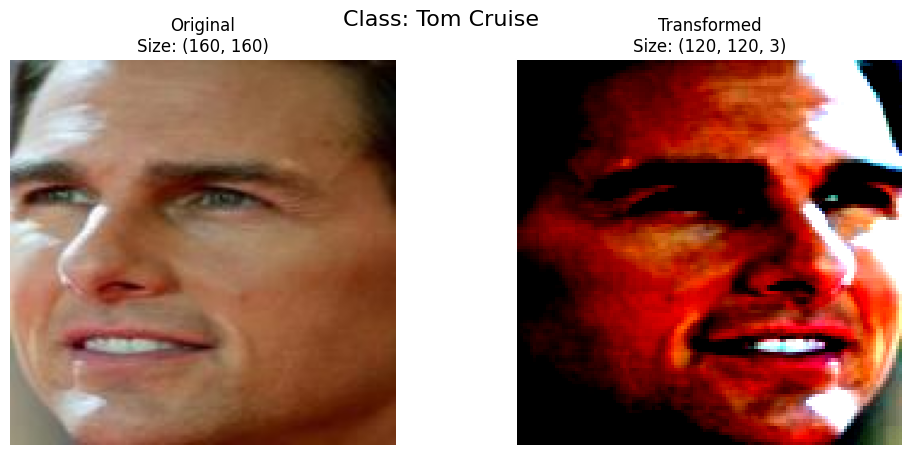

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..1.6666666].


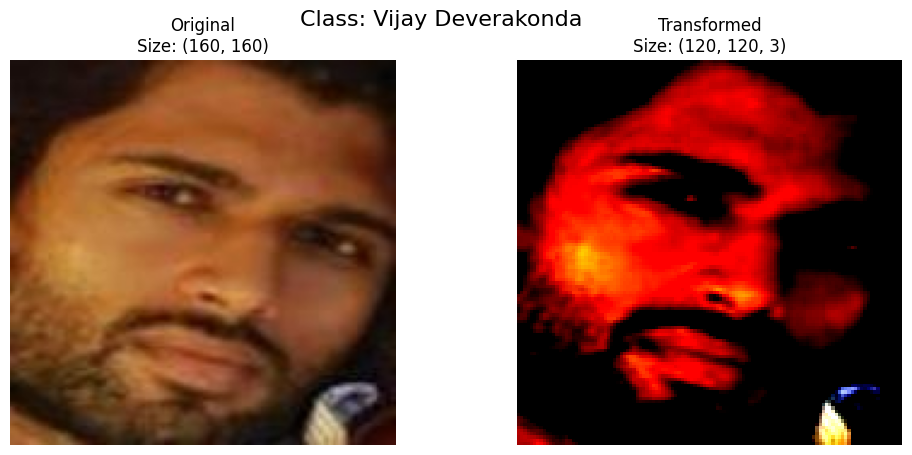

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3785625].


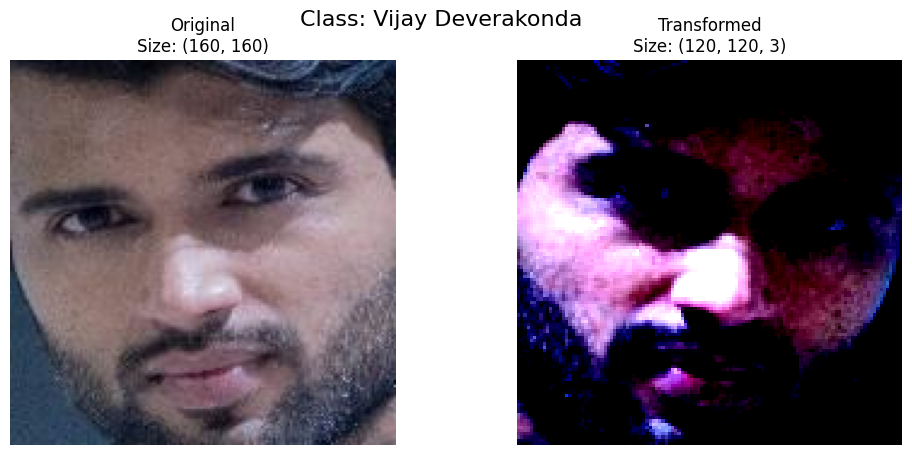

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9481792..1.9577874].


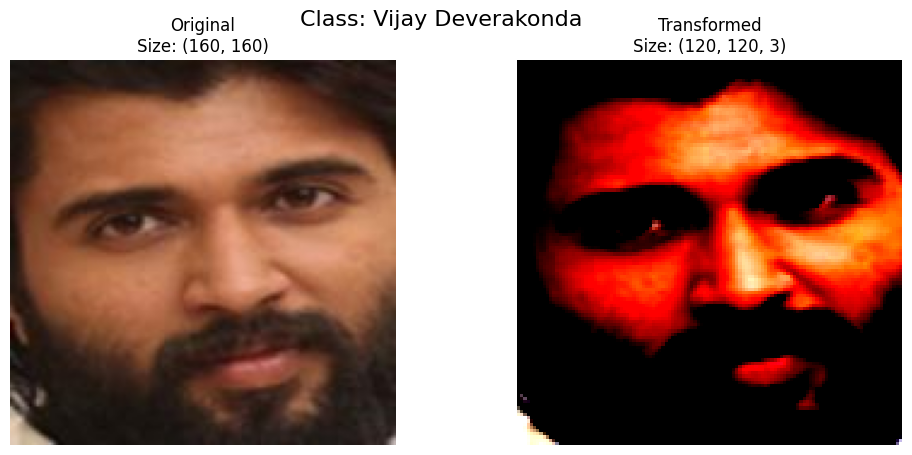

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].


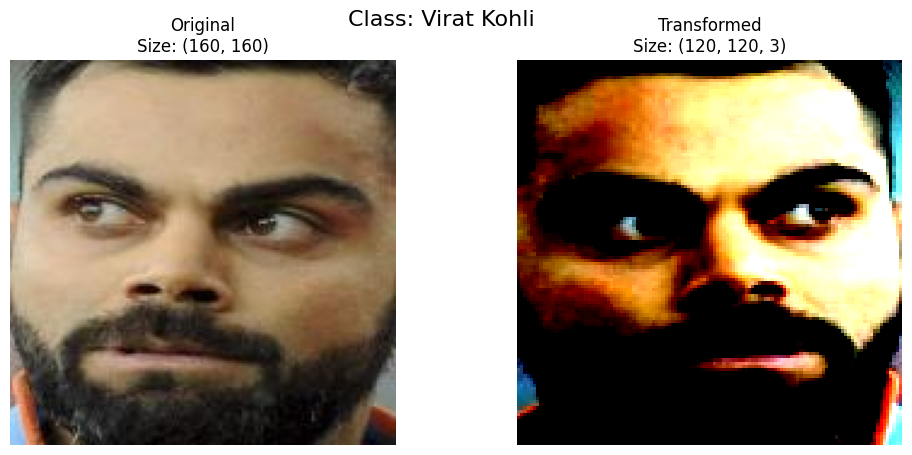

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3060222].


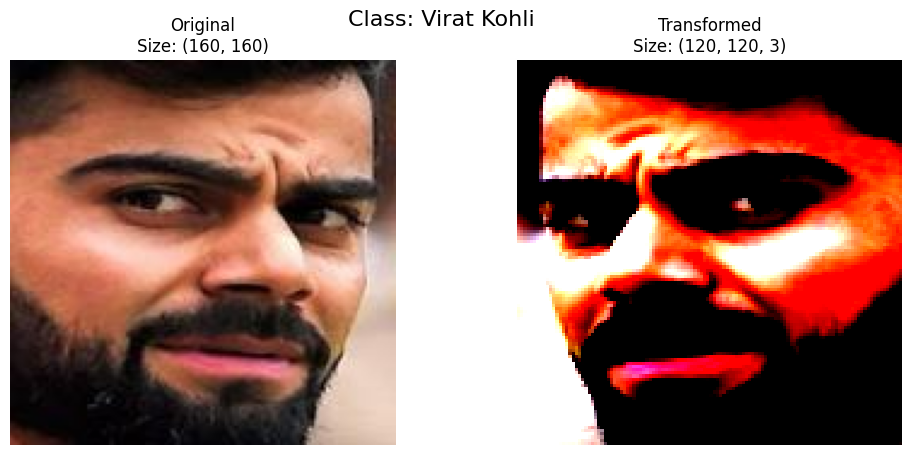

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.64].


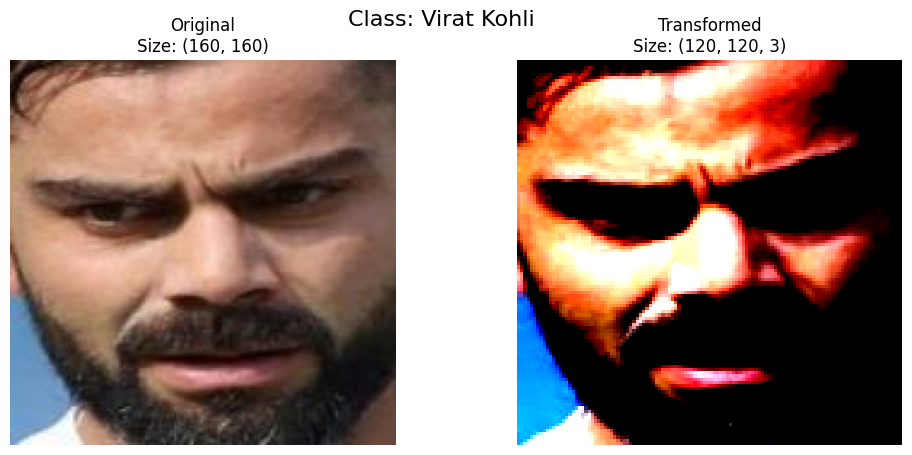

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].


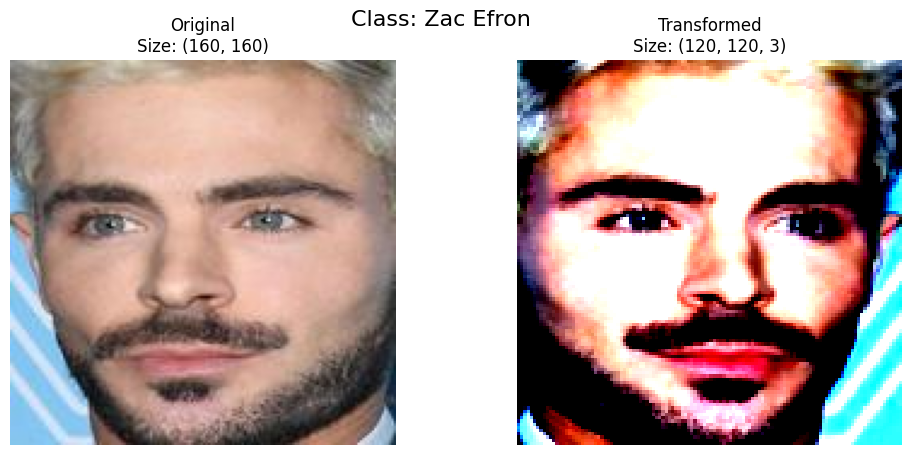

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].


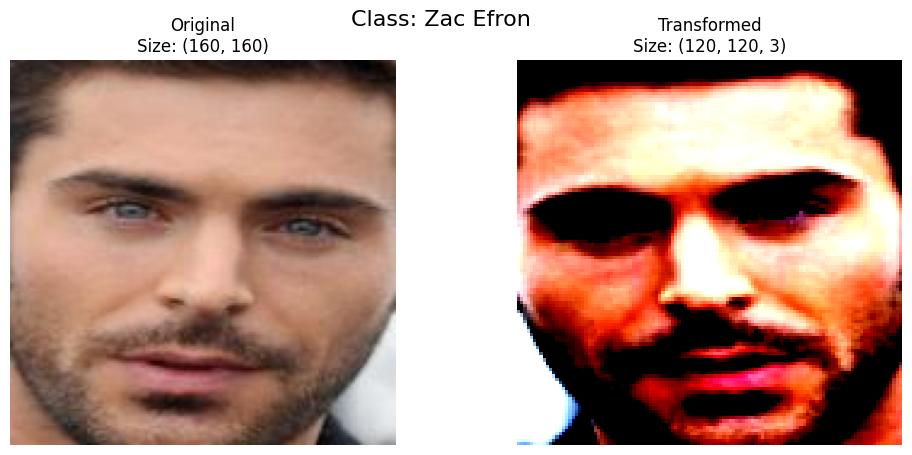

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0182073..2.6051416].


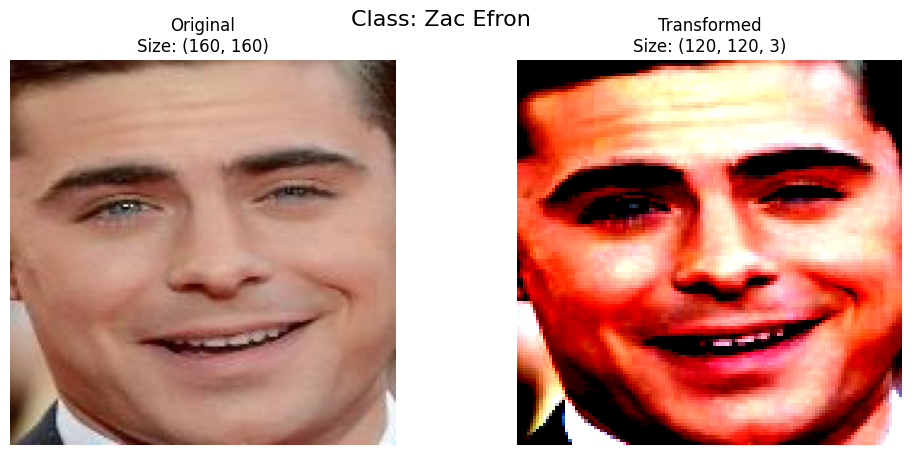

In [15]:
# Example function call
plot_transformed_images(root_dir, transform=data_transform, n=3)

In [8]:
from torch.utils.data import DataLoader, random_split
# train/test split

full_dataset = datasets.ImageFolder(root=root_dir, transform=data_transform)

train_size = int(0.8 * len(full_dataset))
test_size = len(full_dataset) - train_size

# Randomly split the dataset into train and test
train_dataset, test_dataset = random_split(full_dataset, [train_size, test_size])

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

print(f"Train data size: {len(train_dataset)}")
print(f"Test data size: {len(test_dataset)}")

Train data size: 581
Test data size: 146


In [9]:
class_names = full_dataset.classes
class_names

['Akshay Kumar',
 'Alexandra Daddario',
 'Alia Bhatt',
 'Amitabh Bachchan',
 'Andy Samberg',
 'Anushka Sharma',
 'Billie Eilish',
 'Brad Pitt',
 'Camila Cabello',
 'Charlize Theron',
 'Claire Holt',
 'Courtney Cox',
 'Dwayne Johnson',
 'Elizabeth Olsen',
 'Ellen Degeneres',
 'Henry Cavill',
 'Hrithik Roshan',
 'Hugh Jackman',
 'Jessica Alba',
 'Kashyap',
 'Lisa Kudrow',
 'Margot Robbie',
 'Marmik',
 'Natalie Portman',
 'Priyanka Chopra',
 'Robert Downey Jr',
 'Roger Federer',
 'Tom Cruise',
 'Vijay Deverakonda',
 'Virat Kohli',
 'Zac Efron']

In [10]:
# Can also get class names as a dict
class_dict = full_dataset.class_to_idx
class_dict

{'Akshay Kumar': 0,
 'Alexandra Daddario': 1,
 'Alia Bhatt': 2,
 'Amitabh Bachchan': 3,
 'Andy Samberg': 4,
 'Anushka Sharma': 5,
 'Billie Eilish': 6,
 'Brad Pitt': 7,
 'Camila Cabello': 8,
 'Charlize Theron': 9,
 'Claire Holt': 10,
 'Courtney Cox': 11,
 'Dwayne Johnson': 12,
 'Elizabeth Olsen': 13,
 'Ellen Degeneres': 14,
 'Henry Cavill': 15,
 'Hrithik Roshan': 16,
 'Hugh Jackman': 17,
 'Jessica Alba': 18,
 'Kashyap': 19,
 'Lisa Kudrow': 20,
 'Margot Robbie': 21,
 'Marmik': 22,
 'Natalie Portman': 23,
 'Priyanka Chopra': 24,
 'Robert Downey Jr': 25,
 'Roger Federer': 26,
 'Tom Cruise': 27,
 'Vijay Deverakonda': 28,
 'Virat Kohli': 29,
 'Zac Efron': 30}

In [11]:
img, label = next(iter(train_loader))

# Batch size will now be 1, try changing the batch_size parameter above and see what happens
print(f"Image shape: {img.shape} -> [batch_size, color_channels, height, width]")
print(f"Label shape: {label.shape}")

Image shape: torch.Size([32, 3, 120, 120]) -> [batch_size, color_channels, height, width]
Label shape: torch.Size([32])


In [12]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [13]:
model_0 = models.resnet50(pretrained=True).to(device)
# Modify the final layer for your number of classes
num_ftrs = model_0.fc.in_features
# Replace the original fc layer with a new Sequential module that includes Dropout and Linear layers
model_0.fc = nn.Sequential(
    nn.Dropout(0.25),  # Add dropout with a 25% probability
    nn.Linear(num_ftrs, len(labels))  # Followed by a new linear layer for your number of classes
)

d:\DoAnChuyenNganh_TTNT\.venv\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\DoAnChuyenNganh_TTNT\.venv\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [14]:
model_0

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [15]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_0.parameters(), lr=0.002, weight_decay=1e-4)

In [16]:
def train_step(model: torch.nn.Module, dataloader: torch.utils.data.DataLoader, loss_fn: torch.nn.Module, optimizer: torch.optim.Optimizer):
    # Put model in train mode
    model.train()
    
    # Setup train loss and train accuracy values
    train_loss, train_acc = 0, 0
    
    # Loop through data loader data batches
    for batch, (X, y) in enumerate(dataloader):
        # Send data to target device
        X, y = X.to(device), y.to(device)

        # 1. Forward pass
        y_pred = model(X)

        # 2. Calculate  and accumulate loss
        loss = loss_fn(y_pred, y)
        train_loss += loss.item() 

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        # Calculate and accumulate accuracy metric across all batches
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item()/len(y_pred)

    # Adjust metrics to get average loss and accuracy per batch 
    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader)
    return train_loss, train_acc

In [17]:
def test_step(model: torch.nn.Module, 
              dataloader: torch.utils.data.DataLoader, 
              loss_fn: torch.nn.Module):
    # Put model in eval mode
    model.eval() 
    
    # Setup test loss and test accuracy values
    test_loss, test_acc = 0, 0
    
    # Turn on inference context manager
    with torch.inference_mode():
        # Loop through DataLoader batches
        for batch, (X, y) in enumerate(dataloader):
            # Send data to target device
            X, y = X.to(device), y.to(device)
    
            # 1. Forward pass
            test_pred_logits = model(X)

            # 2. Calculate and accumulate loss
            loss = loss_fn(test_pred_logits, y)
            test_loss += loss.item()
            
            # Calculate and accumulate accuracy
            test_pred_labels = test_pred_logits.argmax(dim=1)
            test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))
            
    # Adjust metrics to get average loss and accuracy per batch 
    test_loss = test_loss / len(dataloader)
    test_acc = test_acc / len(dataloader)
    return test_loss, test_acc

In [18]:
print(next(model_0.parameters()).device)

cpu


In [19]:
# Assuming img_batch is a batch of images from DataLoader
img_batch, label_batch = next(iter(train_loader))

# Move a single image to the correct device explicitly
img_single = img_batch[0].unsqueeze(0).to(device)

# Ensure the model is in evaluation mode and on the correct device
model_0.to(device).eval()

# Perform the forward pass
with torch.inference_mode():
    pred = model_0(img_single)

# Output the prediction
print(pred)

tensor([[-0.4335, -0.3405, -0.1211,  0.3092,  0.4638, -0.2077, -0.0909, -0.0428,
         -0.3832,  0.0345, -0.5520,  0.4822,  0.1462, -0.0130, -0.6512,  0.2983,
          0.5498, -0.4395,  0.1168, -0.7357, -0.1685,  0.4040, -0.1545, -0.0441,
          0.3581,  0.0798, -0.4399,  0.4936, -0.5509, -0.9141,  0.4284]])


In [20]:
from tqdm.auto import tqdm

# 1. Take in various parameters required for training and test steps
def train(model: torch.nn.Module, 
          train_dataloader: torch.utils.data.DataLoader, 
          test_dataloader: torch.utils.data.DataLoader, 
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module = nn.CrossEntropyLoss(),
          epochs: int = 5):
    
    # 2. Create empty results dictionary
    results = {"train_loss": [],
        "train_acc": [],
        "test_loss": [],
        "test_acc": []
    }
    
    # 3. Loop through training and testing steps for a number of epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer)
        test_loss, test_acc = test_step(model=model,
            dataloader=test_dataloader,
            loss_fn=loss_fn)
        
        # 4. Print out what's happening
        print(
            f"Epoch: {epoch+1} | "
            f"train_loss: {train_loss:.4f} | "
            f"train_acc: {train_acc:.4f} | "
            f"test_loss: {test_loss:.4f} | "
            f"test_acc: {test_acc:.4f}"
        )

        # 5. Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

    # 6. Return the filled results at the end of the epochs
    return results

d:\DoAnChuyenNganh_TTNT\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [21]:
from timeit import default_timer as timer

# Set random seeds for reproducibility
torch.manual_seed(42) 
torch.cuda.manual_seed(42)

# Set number of epochs
NUM_EPOCHS = 10

# Initialize ResNet50 model for face recognition
model_0 = models.resnet50(pretrained=True)
num_ftrs = model_0.fc.in_features
model_0.fc = nn.Linear(num_ftrs, len(labels))  # Adjust for your number of classes
model_0 = model_0.to(device)

# Setup loss function and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params=model_0.parameters(), lr=0.001)

# Start the timer
start_time = timer()

# Train the model
model_0_results = train(model=model_0, 
                        train_dataloader=train_loader,
                        test_dataloader=test_loader,
                        optimizer=optimizer,
                        loss_fn=loss_fn, 
                        epochs=NUM_EPOCHS)

# Save the trained model  
MODEL_PATH = r"D:\DoAnChuyenNganh_TTNT\AI\algorithm-resnet\saved_models\saved_models.pth"  
torch.save(model_0.state_dict(), MODEL_PATH)  
print(f"Model saved to {MODEL_PATH}")  


# End the timer and print out the training time
end_time = timer()
print(f"Total training time: {end_time-start_time:.3f} seconds")

d:\DoAnChuyenNganh_TTNT\.venv\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\DoAnChuyenNganh_TTNT\.venv\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
 10%|█         | 1/10 [00:47<07:04, 47.19s/it]

Epoch: 1 | train_loss: 2.9459 | train_acc: 0.2497 | test_loss: 14.3841 | test_acc: 0.0785


 20%|██        | 2/10 [01:46<07:14, 54.31s/it]

Epoch: 2 | train_loss: 1.9798 | train_acc: 0.4066 | test_loss: 3.2750 | test_acc: 0.2694


 30%|███       | 3/10 [02:38<06:11, 53.14s/it]

Epoch: 3 | train_loss: 1.4277 | train_acc: 0.5526 | test_loss: 3.0900 | test_acc: 0.3292


 40%|████      | 4/10 [03:27<05:10, 51.73s/it]

Epoch: 4 | train_loss: 1.2061 | train_acc: 0.6247 | test_loss: 2.2677 | test_acc: 0.3694


 50%|█████     | 5/10 [04:15<04:11, 50.35s/it]

Epoch: 5 | train_loss: 1.0817 | train_acc: 0.6526 | test_loss: 1.9890 | test_acc: 0.4590


 60%|██████    | 6/10 [05:05<03:20, 50.19s/it]

Epoch: 6 | train_loss: 0.9097 | train_acc: 0.7082 | test_loss: 3.6669 | test_acc: 0.4014


 70%|███████   | 7/10 [05:53<02:28, 49.51s/it]

Epoch: 7 | train_loss: 0.8895 | train_acc: 0.6954 | test_loss: 2.5796 | test_acc: 0.3826


 80%|████████  | 8/10 [06:41<01:37, 48.98s/it]

Epoch: 8 | train_loss: 0.8826 | train_acc: 0.7306 | test_loss: 2.4508 | test_acc: 0.4486


 90%|█████████ | 9/10 [07:30<00:48, 48.83s/it]

Epoch: 9 | train_loss: 0.6903 | train_acc: 0.7928 | test_loss: 2.0779 | test_acc: 0.4764


100%|██████████| 10/10 [08:18<00:00, 49.82s/it]

Epoch: 10 | train_loss: 0.4759 | train_acc: 0.8556 | test_loss: 1.5833 | test_acc: 0.5944
Model saved to D:\DoAnChuyenNganh_TTNT\AI\algorithm-resnet\saved_models\saved_models.pth
Total training time: 498.298 seconds


In [22]:
# Check the model_0_results keys
model_0_results.keys()

dict_keys(['train_loss', 'train_acc', 'test_loss', 'test_acc'])

In [23]:
from typing import Dict, List

def plot_loss_curves(results: Dict[str, List[float]]):
    """Plots training curves of a results dictionary.

    Args:
        results (dict): dictionary containing list of values, e.g.
            {"train_loss": [...],
             "train_acc": [...],
             "test_loss": [...],
             "test_acc": [...]}
    """
    
    # Get the loss values of the results dictionary (training and test)
    loss = results['train_loss']
    test_loss = results['test_loss']

    # Get the accuracy values of the results dictionary (training and test)
    accuracy = results['train_acc']
    test_accuracy = results['test_acc']

    # Figure out how many epochs there were
    epochs = range(len(results['train_loss']))

    # Setup a plot 
    plt.figure(figsize=(15, 7))

    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, loss, label='train_loss')
    plt.plot(epochs, test_loss, label='test_loss')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.legend()

    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, accuracy, label='train_accuracy')
    plt.plot(epochs, test_accuracy, label='test_accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.legend()

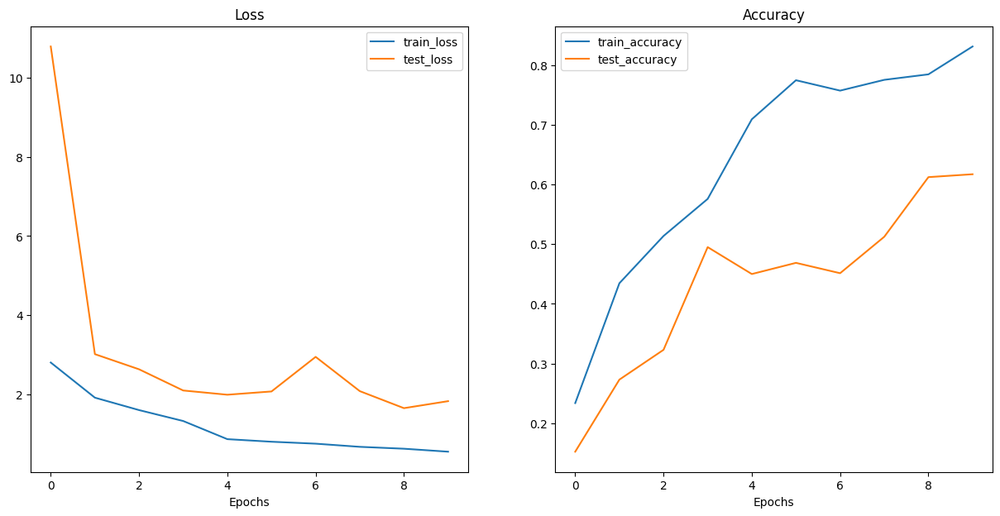

In [34]:
plot_loss_curves(model_0_results)

In [35]:
import torch  
import torch.nn as nn  
from torchvision import models  

# Load the model architecture  
model_0 = models.resnet50(pretrained=False)  # Không sử dụng weights đã huấn luyện trước  
num_ftrs = model_0.fc.in_features  
model_0.fc = nn.Linear(num_ftrs, len(labels))  # Adjust for the number of classes  

# Load the trained weights  
MODEL_PATH = r"D:\DoAnChuyenNganh_TTNT\AI\algorithm-resnet\saved_models\saved_models.pth" 
model_0.load_state_dict(torch.load(MODEL_PATH))  

# Chuyển chế độ sang evaluation  
model_0.eval()  

# Chuyển mô hình vào thiết bị (CPU hoặc GPU)  
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  
model_0.to(device)  

C:\Users\Admin\AppData\Local\Temp\ipykernel_7660\2057151662.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_0.load_state_dict(torch.load(MODEL_PATH))


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [29]:
label_names = [
    "Akshay Kumar",
    "Alexandra Daddario",
    "Alia Bhatt",
    "Amitabh Bachchan",
    "Andy Samberg",
    "Anushka Sharma",
    "Billie Eilish",
    "Brad Pitt",
    "Camila Cabello",
    "Charlize Theron",
    "Claire Holt",
    "Courtney Cox",
    "Dwayne Johnson",
    "Elizabeth Olsen",
    "Ellen Degeneres",
    "Henry Cavill",
    "Hrithik Roshan",
    "Hugh Jackman",
    "Jessica Alba",
    "Kashyap",
    "Lisa Kudrow",
    "Margot Robbie",
    "Marmik",
    "Natalie Portman",
    "Priyanka Chopra",
    "Robert Downey Jr",
    "Roger Federer",
    "Tom Cruise",
    "Vijay Deverakonda",
    "Virat Kohli",
    "Zac Efron"
]

In [ ]:
import torch  
import torch.nn as nn  
from torchvision import models  

# Load the model architecture  
model_0 = models.resnet50(pretrained=False) 
num_ftrs = model_0.fc.in_features
model_0.fc = nn.Linear(num_ftrs, len(labels)) 


# Load the trained weights  
MODEL_PATH = r"D:\DoAnChuyenNganh_TTNT\AI\algorithm-resnet\saved_models\saved_models.pth" 
model =  model_0.load_state_dict(torch.load(MODEL_PATH))  

# Chuyển chế độ sang evaluation  
model_0.eval()  

# Chuyển mô hình vào thiết bị (CPU hoặc GPU)  
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  
model_0.to(device)  
print(model_0.to(device))

In [47]:
import cv2  
import numpy as np  

# Khởi tạo face detector  
face_detector = cv2.CascadeClassifier(r"D:\DoAnChuyenNganh_TTNT\AI\algorithm-resnet\haarcascades\haarcascade_frontalface_alt.xml")  

# Mở camera  
camera = cv2.VideoCapture(0)  
# camera = cv2.imread(r"D:\DoAnChuyenNganh_TTNT\datasets\Akshay Kumar\Akshay Kumar_5.jpg")

while True:  
    ok, frame = camera.read()
    if not ok:  
        print("Failed to capture video")  
        break  
    
    # Phát hiện khuôn mặt  
    faces = face_detector.detectMultiScale(frame, 1.3, 5)  

    for (x, y, w, h) in faces:  
        roi = cv2.resize(frame[y:y+h, x:x+w], (250, 250))  # Resize mẫu khuôn mặt  
        roi = roi / 255.0  # Chuẩn hóa dữ liệu  
        roi = np.transpose(roi, (2, 0, 1))  # Chuyển đổi từ (250, 250, 3) sang (3, 250, 250)  
        roi = torch.tensor(roi, dtype=torch.float32).unsqueeze(0).to(device)  # Thêm batch dimension và gửi đến device  
        
        # Dự đoán  
        with torch.no_grad():  
            result = model_0(roi)  
            predicted_class = torch.argmax(result, dim=1).item()  # Lấy lớp dự đoán cao nhất  
            print(predicted_class)
        
        # Vẽ khung và nhãn  
        cv2.rectangle(frame, (x, y), (x+w, y+h), (128, 255, 50), 1)  
        cv2.putText(frame, labels[predicted_class], (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)  # Vẽ nhãn  

    # Hiện thị khung hình  
    cv2.imshow('frame', frame)  
    
    if cv2.waitKey(1) & 0xFF == ord("q"):  
        break  

# Giải phóng camera  
camera.release()  
cv2.destroyAllWindows() 

17
17
6
17
6
6
6
6
6
6
6
6
6
6
6
6
17
17
17
17
6
6
6
6
17
6
17
6
17
17
17
17
17
17
6
17
6
6
6
6
6
6
6
6
6
17
6
6
6
6
17
6
17
17
17
17
17
17
17
17
17
17
17
6
6
6
6


KeyboardInterrupt: 